# Final Annotations - Individual cell lineage objects

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scirpy as ir
import scipy
import sctk as sk
import seaborn as sb
import scrublet as scr
import matplotlib.pyplot as mpl
from matplotlib.pyplot import rc_context
from glob import glob
import tarfile
import anndata
import warnings


sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='OrRd')
sc.logging.print_header()


scanpy==1.8.2 anndata==0.8.0 umap==0.5.3 numpy==1.21.1 scipy==1.7.0 pandas==1.5.3 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
def find_marker_genes (adata):
    
    pts = adata.uns['rank_genes_groups']['pts']
    pts_rest = adata.uns['rank_genes_groups']['pts_rest']

    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names

    res = pd.DataFrame(index=range(0, pts.shape[0]))
    for group in groups:
        df = pd.DataFrame({group + '_' + key: result[key][group] for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges']})
        df[group+'_pts'] = pts.loc[df[group + '_names'], group].values
        df[group+'_pts_rest'] = pts_rest.loc[df[group + '_names'], group].values
        res = res.join(df)


    output = pd.DataFrame()
    for group in groups:
           sub_res = res[[f"{group}_{key}" for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges', 'pts','pts_rest']]]
           sub_res.columns = ['names', 'pvals', 'pvals_adj', 'logfoldchanges', 'pts','pts_rest']
           sub_res['celltype'] = group
           flag = (sub_res['pvals'] < 0.05) & (sub_res['pts'] > 0.5) & (sub_res['pts_rest'] < 0.2)
           sub_res = sub_res[flag]
           output = output.append(sub_res)
    return output

### Final annotated object (Fig.2c-d)

In [4]:
adata=sc.read('/nfs/team205/rb29/mice_gutTCRtg_project/data/h5ad_objects/mice-gut.TCRtg/latest/mice4samples_Celltypist_afterQC.h5ad')

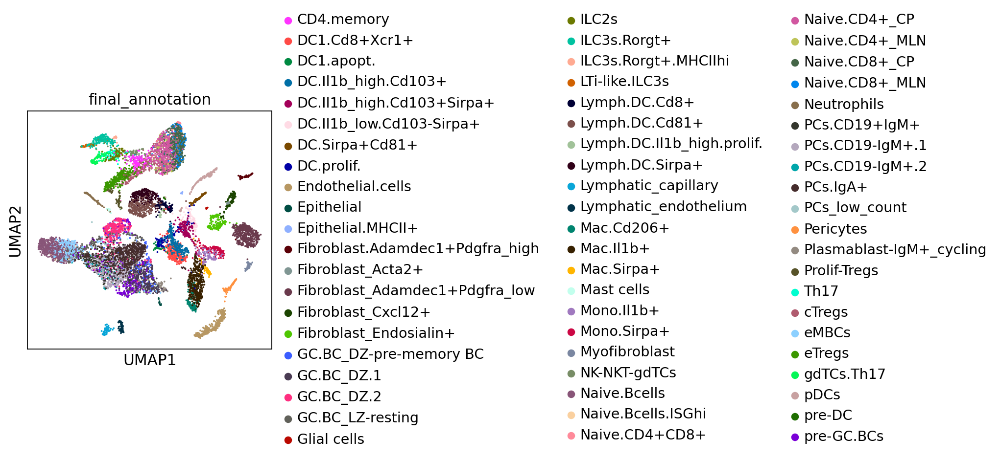

In [5]:
sc.pl.umap(adata, color="final_annotation")

<AxesSubplot:title={'center':'final_annotation'}, xlabel='UMAP1', ylabel='UMAP2'>

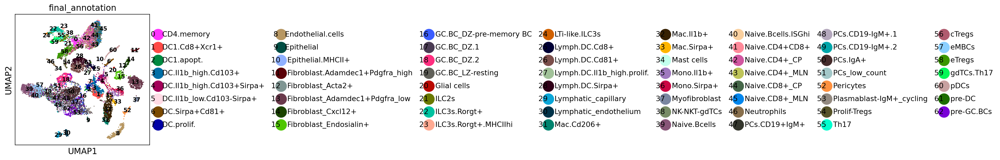

In [6]:
## stk plot:
sk.plot_embedding(adata, basis="umap", groupby='final_annotation')

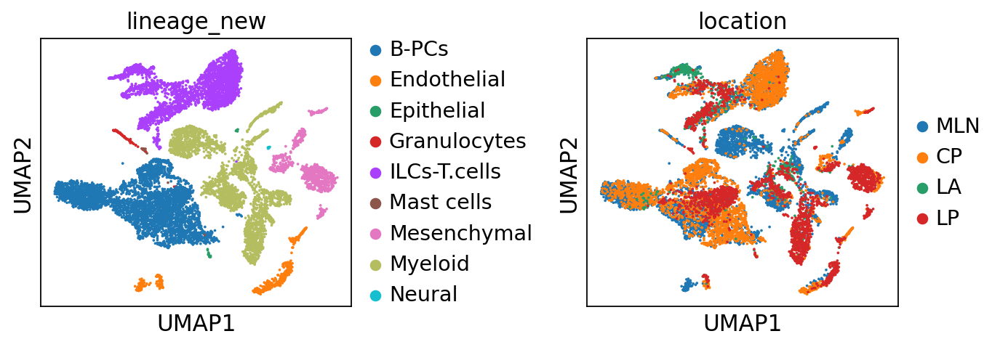

In [7]:
with mpl.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=['lineage_new', 'location'], wspace=0.6)

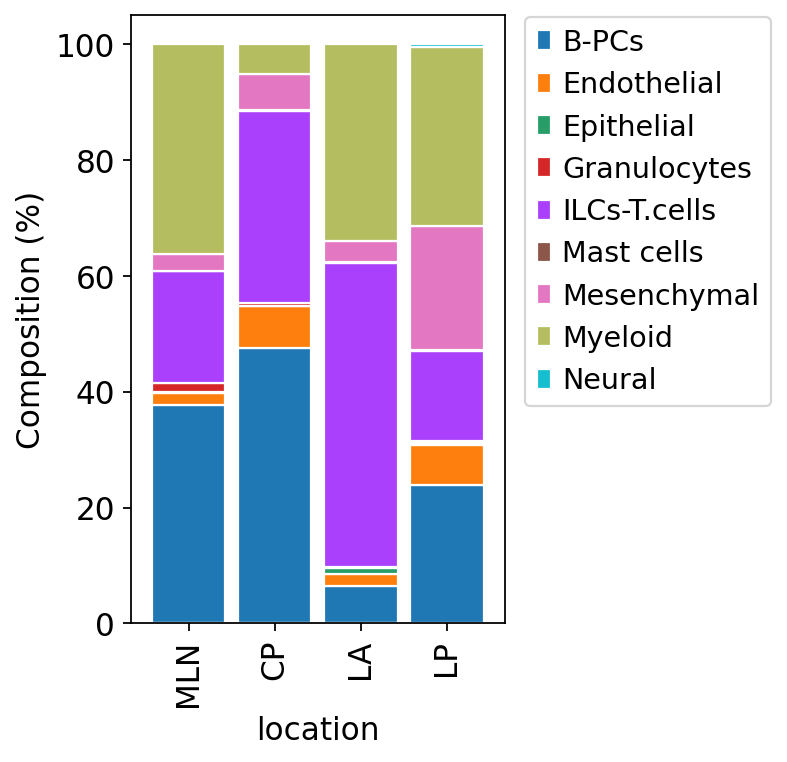

In [8]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    mpl.rcParams['pdf.fonttype'] = 42
    mpl.rcParams['ps.fonttype'] = 42
    tmp0 = pd.crosstab(adata.obs['location'], adata.obs['lineage_new'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot1=tmp0.reindex(sort_mapping.index)
    plot1.plot(kind='bar', stacked=True, color= adata.uns['lineage_new_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/FinalUmap_all_NoDoublets_lineages2_bar.pdf', format='pdf')

In [9]:
tmp0.T.to_csv("Fig2D_Barplot_allLineages.csv")

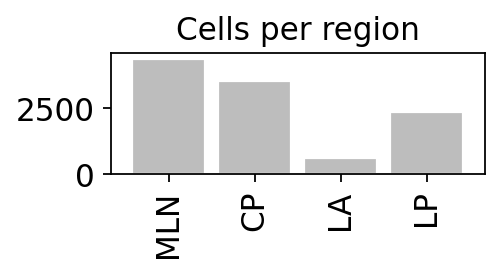

In [10]:
with mpl.rc_context({'figure.figsize': (3, 1)}):
    mpl.rcParams['pdf.fonttype'] = 42
    mpl.rcParams['ps.fonttype'] = 42
    tmp1 =adata.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot1=tmp1.reindex(sort_mapping.index)
    plot1.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/FinalUmap_all_NoDoublets_cells.pdf', format='pdf')

In [11]:
tmp1

MLN    4371
CP     3509
LP     2337
LA      614
Name: location, dtype: int64

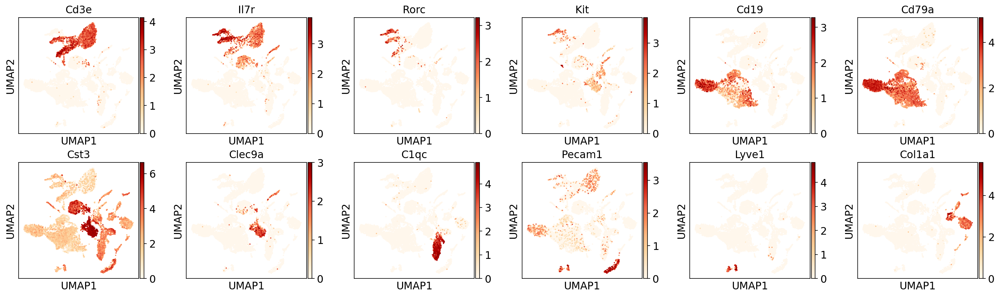

In [12]:
with mpl.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color = ['Cd3e','Il7r','Rorc','Kit','Cd19','Cd79a','Cst3',"Clec9a",'C1qc', 'Pecam1','Lyve1', 'Col1a1']
               ,legend_fontsize=10, legend_fontoutline=1,ncols=6)

In [13]:
sc.tl.rank_genes_groups(adata, groupby="final_annotation", method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:41)


In [14]:
de_allLineages = find_marker_genes(adata)

In [15]:
de_allLineages

,names,pvals,pvals_adj,logfoldchanges,pts,pts_rest,celltype
4,Cd3e,3.358878e-38,1.298542e-34,3.653492,0.846774,0.194172,CD4.memory
6,Cd3d,9.403091e-35,2.596596e-31,3.520400,0.814516,0.195480,CD4.memory
16,Lat,6.801247e-27,6.573405e-24,3.314130,0.693548,0.181657,CD4.memory
23,Ms4a4b,9.560982e-23,6.600492e-20,3.265958,0.637097,0.152797,CD4.memory
42,Trbc2,8.156029e-17,3.031847e-14,2.816939,0.580645,0.168955,CD4.memory
...,...,...,...,...,...,...,...
4379,Mgat2,1.205150e-11,5.260965e-11,0.507836,0.505837,0.197087,pre-GC.BCs
4389,Ubr4,1.334812e-11,5.812053e-11,0.253836,0.509728,0.192075,pre-GC.BCs
4427,Unc50,2.006024e-11,8.661254e-11,0.363105,0.505837,0.194723,pre-GC.BCs
4539,Cnot4,6.705129e-11,2.822521e-10,0.132392,0.505837,0.193683,pre-GC.BCs


In [16]:
# Format table
celltypeLin=adata.obs[["final_annotation",'lineage_new']]

newdf = celltypeLin.drop_duplicates(
  subset = ["final_annotation",'lineage_new'],
  keep = 'last').reset_index(drop = True)
  
df=newdf.set_index("final_annotation")

out=de_allLineages
ON = {O:N for O,N in zip(df.index, df.lineage_new)}
out["lineage"] = [ON[O] if O in ON else N for O,N in zip(out.celltype, out.names)]
display(out)

,names,pvals,pvals_adj,logfoldchanges,pts,pts_rest,celltype,lineage
4,Cd3e,3.358878e-38,1.298542e-34,3.653492,0.846774,0.194172,CD4.memory,ILCs-T.cells
6,Cd3d,9.403091e-35,2.596596e-31,3.520400,0.814516,0.195480,CD4.memory,ILCs-T.cells
16,Lat,6.801247e-27,6.573405e-24,3.314130,0.693548,0.181657,CD4.memory,ILCs-T.cells
23,Ms4a4b,9.560982e-23,6.600492e-20,3.265958,0.637097,0.152797,CD4.memory,ILCs-T.cells
42,Trbc2,8.156029e-17,3.031847e-14,2.816939,0.580645,0.168955,CD4.memory,ILCs-T.cells
...,...,...,...,...,...,...,...,...
4379,Mgat2,1.205150e-11,5.260965e-11,0.507836,0.505837,0.197087,pre-GC.BCs,B-PCs
4389,Ubr4,1.334812e-11,5.812053e-11,0.253836,0.509728,0.192075,pre-GC.BCs,B-PCs
4427,Unc50,2.006024e-11,8.661254e-11,0.363105,0.505837,0.194723,pre-GC.BCs,B-PCs
4539,Cnot4,6.705129e-11,2.822521e-10,0.132392,0.505837,0.193683,pre-GC.BCs,B-PCs


In [17]:
out.to_csv('GEtable_markers-AllLineages_final.csv', header=True, index=False)

# MHC-class II scoring
Genes: H2-Ab1, H2-Ab1, and Cd74 <br>
Genes starting by H2:<br>
['H2-DMa', 'H2-DMb2', 'H2-DMb1', 'H2-Ob', 'H2-Ab1', 'H2-Aa', 'H2-Eb1', 'H2-Eb2', 'H2-Q4', 'H2-Q6', 'H2-M2', 'Cd74']
Based on http://www.imgt.org/IMGTrepertoireMH/LocusGenes/nomenclatures/mouse/MHC/Mu_MHCnom.html

In [18]:
MHCII_prefixes=("H2-A","H2-E",'H2-DM','H2-O','H2-P',"Cd74")#Remove Ciita
sMHCII_genes = adata.var_names[adata.var_names.str.startswith(MHCII_prefixes)]
print(sMHCII_genes)

Index(['H2-Oa', 'H2-DMa', 'H2-DMb2', 'H2-DMb1', 'H2-Ob', 'H2-Ab1', 'H2-Aa',
       'H2-Eb1', 'H2-Eb2', 'Cd74'],
      dtype='object')


List of proteins involved in MHC-II presentation from https://reactome.org/PathwayBrowser/#/R-MMU-2132295&DTAB=MT Ids #mapped with https://www.uniprot.org/mapping/

In [19]:
AgPresent_genes = [x.strip() for x in open('/home/jovyan/Miscelanea/Gene_lists/20220301_List of genes MHC-II mouse.txt')]
AgPresent = [x for x in AgPresent_genes if x in adata.var_names]
print(AgPresent)

['Actr10', 'Actr1a', 'Actr1b', 'Ap1b1', 'Ap1g1', 'Ap1m1', 'Ap1m2', 'Ap1s1', 'Ap1s2', 'Ap1s3', 'Ap2a1', 'Ap2a2', 'Ap2b1', 'Ap2m1', 'Ap2s1', 'Arf1', 'Canx', 'Capza1', 'Capza2', 'Capzb', 'Cd74', 'Cenpe', 'Clta', 'Cltc', 'Ctsa', 'Ctsb', 'Ctsc', 'Ctsd', 'Ctse', 'Ctsf', 'Ctsh', 'Ctsk', 'Ctsl', 'Ctso', 'Ctss', 'Dctn1', 'Dctn2', 'Dctn3', 'Dctn4', 'Dctn5', 'Dctn6', 'Dnm1', 'Dnm2', 'Dnm3', 'Dync1h1', 'Dync1i2', 'Dync1li1', 'Dync1li2', 'Dynll1', 'Dynll2', 'H2-Aa', 'H2-Ab1', 'H2-DMa', 'H2-DMb2', 'H2-Eb1', 'H2-Eb2', 'H2-Oa', 'H2-Ob', 'Ifi30', 'Kif11', 'Kif15', 'Kif18a', 'Kif20a', 'Kif22', 'Kif23', 'Kif26a', 'Kif2a', 'Kif2c', 'Kif3a', 'Kif3b', 'Kif3c', 'Kif4', 'Kif5a', 'Kif5b', 'Kifap3', 'Klc1', 'Klc2', 'Klc3', 'Klc4', 'Lag3', 'Lgmn', 'Osbpl1a', 'Racgap1', 'Rilp', 'Sar1b', 'Sec13', 'Sec23a', 'Sec24a', 'Sec24b', 'Sec24c', 'Sec24d', 'Sec31a', 'Sh3gl2', 'Sptbn2', 'Tuba1a', 'Tuba1b', 'Tuba1c', 'Tuba3b', 'Tuba4a', 'Tuba8', 'Tubal3', 'Tubb2a', 'Tubb2b', 'Tubb3', 'Tubb4a', 'Tubb4b', 'Tubb6']


In [20]:
MHCI_prefixes=("H2-D1","H2-K1", "H2-L","H2-Q","H2-M","H2-T")#H2-M, Q and T, non-classical
MHCI_genes = list(adata.var_names[adata.var_names.str.startswith(MHCI_prefixes)])
print(MHCI_genes)

['H2-K1', 'H2-D1', 'H2-Q1', 'H2-Q2', 'H2-Q4', 'H2-Q6', 'H2-Q7', 'H2-Q10', 'H2-T24', 'H2-T23', 'H2-T22', 'H2-T3', 'H2-M5', 'H2-M3', 'H2-M2']


In [21]:
sc.tl.score_genes(adata, sMHCII_genes, score_name='sMHCII_score')
sc.tl.score_genes(adata, AgPresent, score_name='AgPresent_score')
sc.tl.score_genes(adata, MHCI_genes, score_name='MHCI_score')

computing score 'sMHCII_score'
    finished: added
    'sMHCII_score', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'AgPresent_score'
    finished: added
    'AgPresent_score', score of gene set (adata.obs).
    993 total control genes are used. (0:00:00)
computing score 'MHCI_score'
    finished: added
    'MHCI_score', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)


### Violin plots for the MHC-II scores in LA and LP

In [206]:
adata_LA =adata[adata.obs["location"].isin(['LA'])].copy()

In [210]:
adata_LAsel = adata_LA[adata_LA.obs['final_annotation'].isin(['DC.Il1b_high.Cd103+Sirpa+','DC.Il1b_high.Cd103+','Mac.Il1b+','ILC3s.Rorgt+','eTregs'])].copy()

In [214]:
dict(zip(adata_LAsel.obs['final_annotation'].cat.categories, adata_LAsel.uns[f"{'final_annotation'}_colors"]))

{'DC.Il1b_high.Cd103+': '#006fa6',
 'DC.Il1b_high.Cd103+Sirpa+': '#a30059',
 'ILC3s.Rorgt+': '#00c2a0',
 'Mac.Il1b+': '#372101',
 'eTregs': '#3b9700'}

In [220]:
adata_LAsel.uns["final_annotation_colors"]=['#bec1d4ff','#d6bcc0ff','#bcbd22ff','#fee0b6ff','#4a6fe3ff']

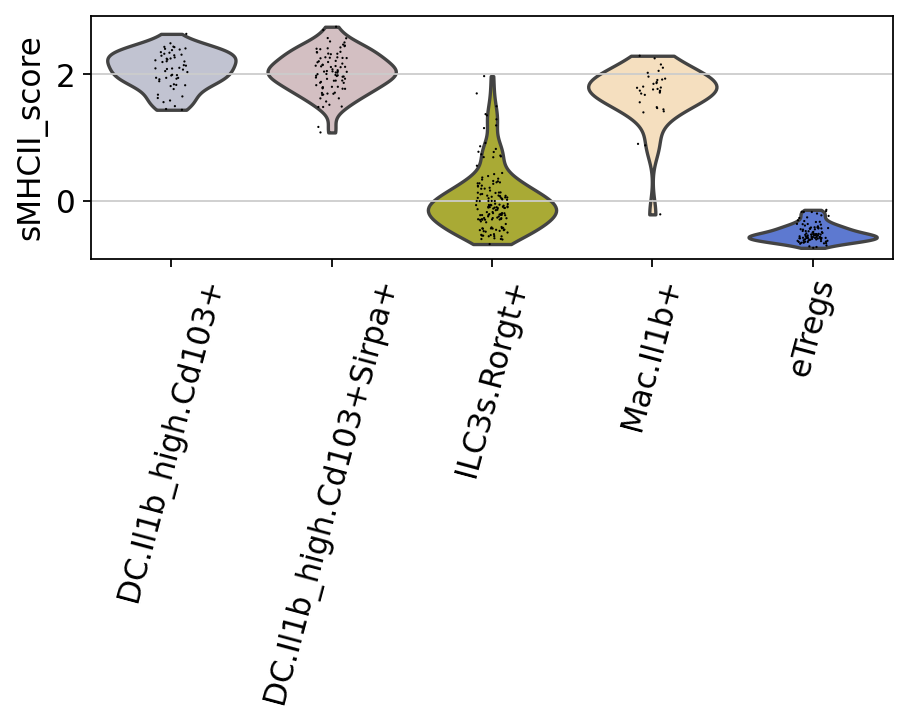

In [221]:
with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(adata_LAsel, 'sMHCII_score', order=['DC.Il1b_high.Cd103+','DC.Il1b_high.Cd103+Sirpa+','ILC3s.Rorgt+','Mac.Il1b+','eTregs'], groupby='final_annotation',rotation=75)

In [222]:
adata_LP =adata[adata.obs["location"].isin(['LP'])].copy()

In [226]:
adata_LPsel = adata_LP[adata_LP.obs['final_annotation'].isin(['CD4.memory','DC.Il1b_high.Cd103+','DC.Il1b_high.Cd103+Sirpa+','DC.prolif.','ILC2s','Mac.Cd206+','Mac.Il1b+','Mono.Il1b+','NK-NKT-gdTCs','eTregs'])].copy()

In [231]:
adata_LPsel.uns["final_annotation_colors"]=['#d33f6aff','#bec1d4ff','#d6bcc0ff','#4a6fe3ff','#e377c2ff','#fdae61ff','#fee0b6ff','#f46d43ff','#11c638ff','#4a6fe3ff']

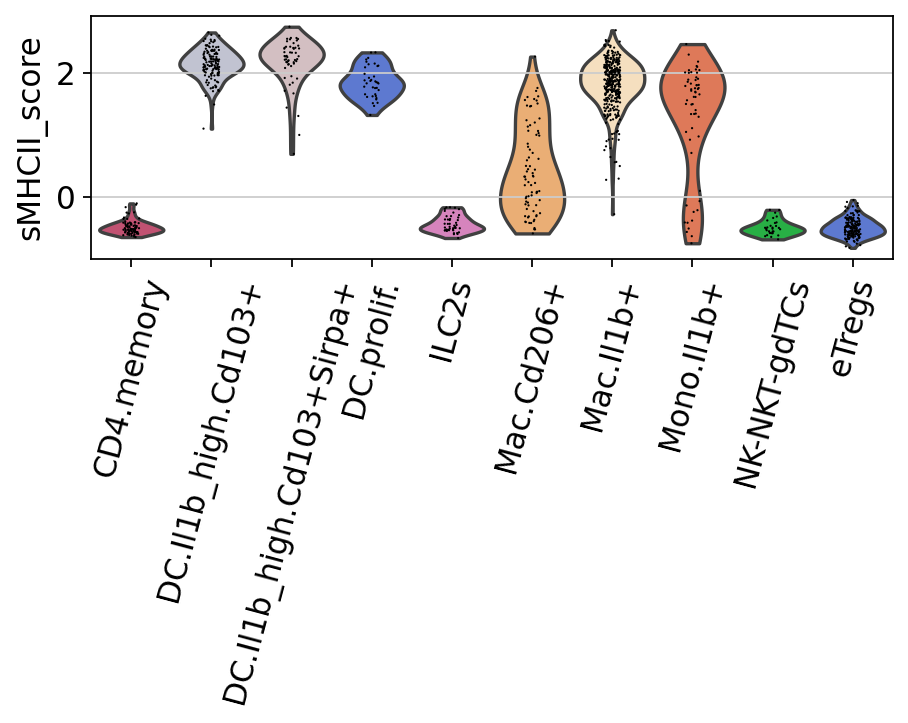

In [232]:
with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(adata_LPsel, 'sMHCII_score', order=['CD4.memory','DC.Il1b_high.Cd103+','DC.Il1b_high.Cd103+Sirpa+','DC.prolif.','ILC2s','Mac.Cd206+','Mac.Il1b+','Mono.Il1b+','NK-NKT-gdTCs','eTregs'],groupby='final_annotation',rotation=75)

# Annotations in each individual lingeage object

In [24]:
path='/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis'

## T cells- ILCs (Fig.2e)

In [25]:
adata_lymph=sc.read(path+"/h5ad_files/TCs-ILCs.NoDoub_final_newNames.h5ad")

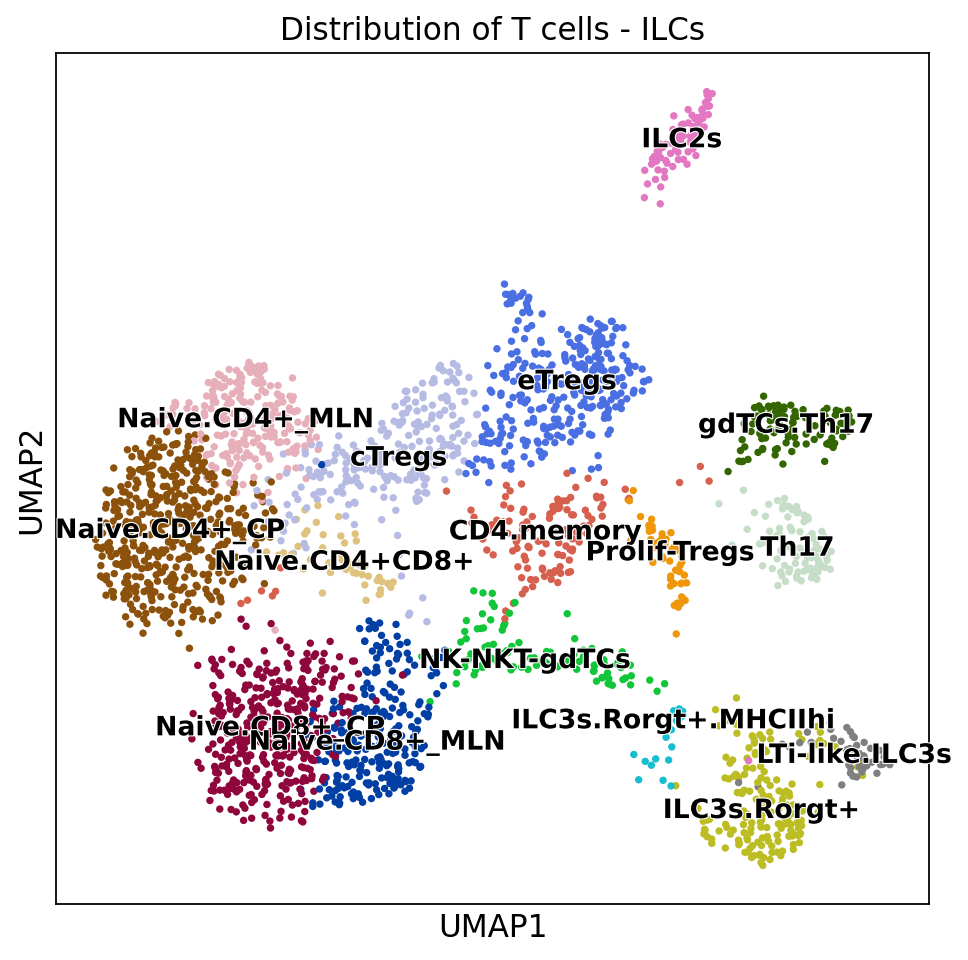

In [26]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_lymph, color = ['cell_subset_new'], 
               title="Distribution of T cells - ILCs",
               legend_loc='on data',legend_fontsize=12, legend_fontoutline=1)


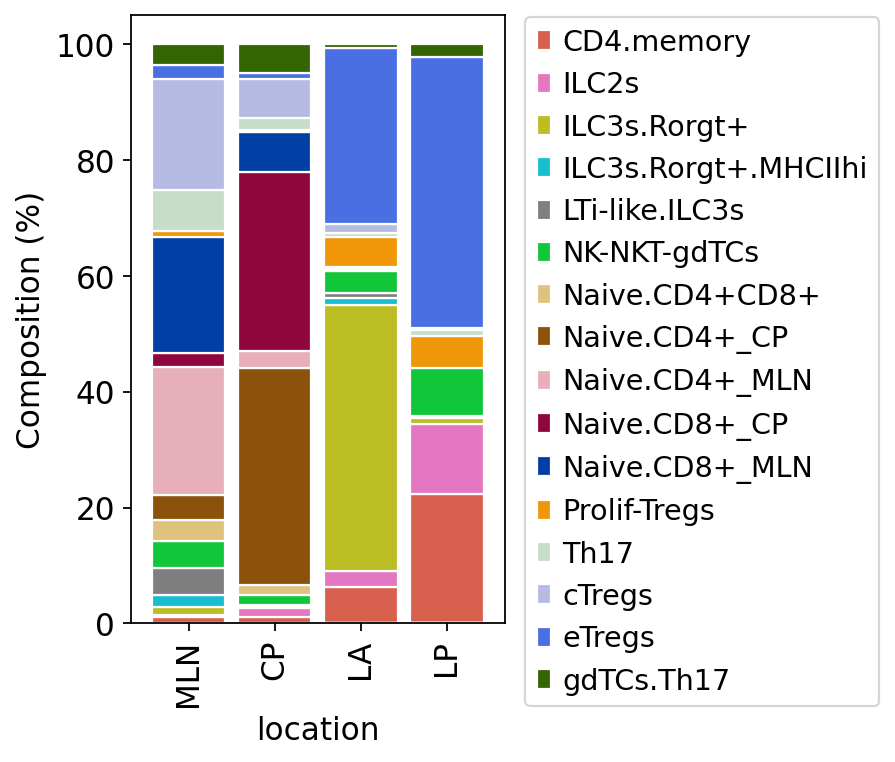

In [27]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp = pd.crosstab(adata_lymph.obs['location'], adata_lymph.obs['cell_subset_new'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot=tmp.reindex(sort_mapping.index)
    plot.plot(kind='bar', stacked=True, color= adata_lymph.uns['cell_subset_new_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/TC-ILCsfinal_NoDoublets_bar_new2.pdf', format='pdf')

In [28]:
tmp.T.to_csv("Fig2E_Barplot_TcellsILCs.csv")

In [29]:
adata_lymph.obs['location'].value_counts()

CP     1164
MLN     849
LP      363
LA      322
Name: location, dtype: int64

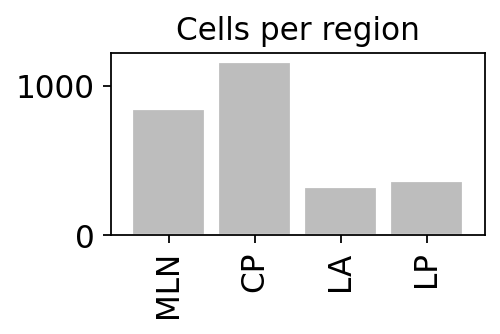

In [30]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp =adata_lymph.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot=tmp.reindex(sort_mapping.index)
    plot.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/TC-ILCsfinal_NoDoublets_cells_2.pdf', format='pdf')

In [32]:
sc.tl.rank_genes_groups(adata_lymph, 'cell_subset_new', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


In [33]:
de_TcellsILCs = find_marker_genes(adata_lymph)

In [34]:
de_TcellsILCs.to_csv('GEtable_markers-TcellsILCs.csv', header=True, index=False)

## T cells (SuppFig.3a)

In [35]:
adata_TCs=sc.read(path+"/h5ad_files/adata_TCs_only_newLabels.h5ad")

In [36]:
adata_TCs.obs

,IR_VJ_1_locus,IR_VJ_2_locus,IR_VDJ_1_locus,IR_VDJ_2_locus,IR_VJ_1_cdr3,IR_VJ_2_cdr3,IR_VDJ_1_cdr3,IR_VDJ_2_cdr3,IR_VJ_1_cdr3_nt,IR_VJ_2_cdr3_nt,...,cell_type,cell_lineage,leiden_TC_ori,cell_subset,leiden_TC,leiden_TCsplit12,cell_subset_int,cell_subset_final,leiden_TCs_only,cell_subset_new
AAACCTGCAACGATGG-1-0,TRA,NaN,TRB,NaN,CALGTGGNNKLTF,None,CASSQPGQGDVFF,None,TGTGCTCTGGGGACTGGAGGCAATAATAAGCTGACTTTT,None,...,Memory TCs,ILCs-TCs,4,cTregs,4,4,cTregs,cTregs,2,cTregs
AAACCTGGTACCTACA-1-0,TRA,NaN,TRB,NaN,CAASKAGGYKVVF,None,CASGDSGGYEQYF,None,TGTGCAGCAAGCAAGGCTGGAGGCTATAAAGTGGTCTTT,None,...,Naïve T cells,ILCs-TCs,5,Naïve.CD4+.pop2,5,5,Naïve.CD4+.pop2,Naïve.CD4+.pop2,4,Naive.CD4+_MLN
AAAGATGTCCTTTCTC-1-0,TRA,NaN,TRB,NaN,CAMEGGRALIF,None,CGADSGQINERLFF,None,TGTGCTATGGAGGGAGGCAGAGCTCTGATATTT,None,...,Naïve T cells,ILCs-TCs,3,Naïve.CD8+.pop2,3,3,Naïve.CD8+.pop2,Naïve.CD8+.pop2,5,Naive.CD8+_MLN
AAAGCAACAGACGCTC-1-0,TRA,NaN,TRB,NaN,CADRGSALGRLHF,None,CASGDARGREDTQYF,None,TGTGCAGATAGAGGTTCAGCCTTAGGGAGGCTGCATTTT,None,...,Naïve T cells,ILCs-TCs,5,Naïve.CD4+.pop2,5,5,Naïve.CD4+.pop2,Naïve.CD4+.pop2,2,Naive.CD4+_MLN
AAAGCAAGTAGGACAC-1-0,NaN,NaN,TRB,NaN,None,None,CASSQDPERLFF,None,None,None,...,Naïve T cells,ILCs-TCs,5,Naïve.CD4+.pop2,5,5,Naïve.CD4+.pop2,Naïve.CD4+.pop2,4,Naive.CD4+_MLN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTATGCTCGGAGGTA-1-3,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,...,Memory TCs,ILCs-TCs,7,CD4.memory,7,7,CD4.memory,CD4.memory,6,CD4.memory
TTTCCTCGTTTGTTGG-1-3,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,...,Memory TCs,ILCs-TCs,2,eTregs,2,2,eTregs,eTregs,3,eTregs
TTTGCGCGTCCGTTAA-1-3,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,...,Memory TCs,ILCs-TCs,2,eTregs,2,2,eTregs,eTregs,12,eTregs
TTTGGTTTCATGCATG-1-3,TRA,NaN,TRB,NaN,CAAITNTGKLTF,None,CASSPGWGEAEQFF,None,TGTGCAGCAATCACCAATACAGGCAAATTAACCTTT,None,...,Memory TCs,ILCs-TCs,15,Prolif-Tregs,15,15,Prolif-Tregs,Prolif-Tregs,11,Prolif-Tregs


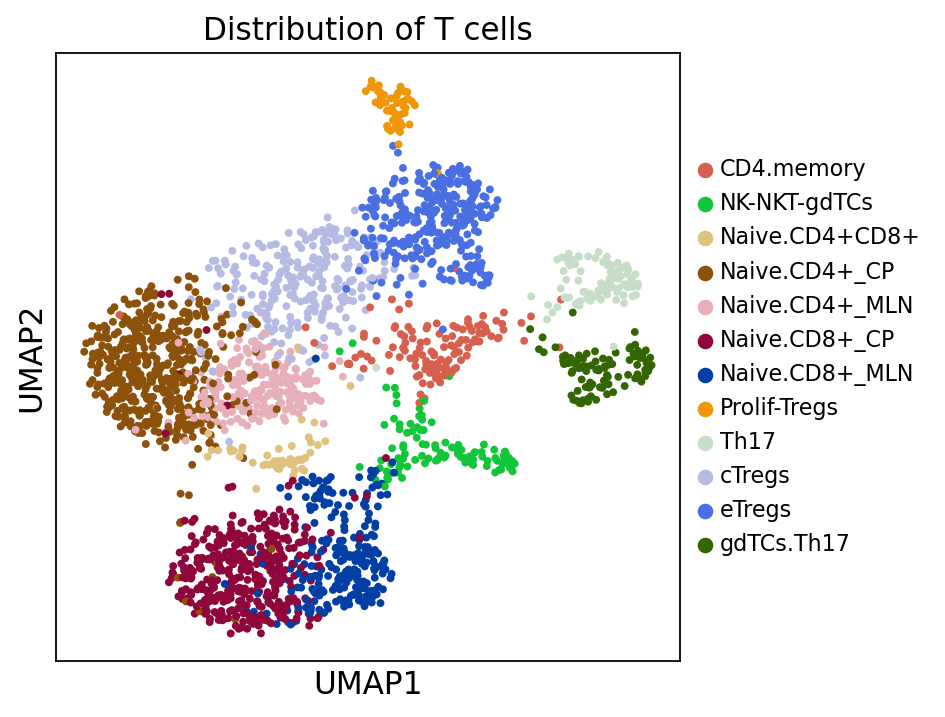

In [37]:
with mpl.rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata_TCs, color = ['cell_subset_new'], 
               title="Distribution of T cells",
                legend_fontsize=10, legend_fontoutline=1)

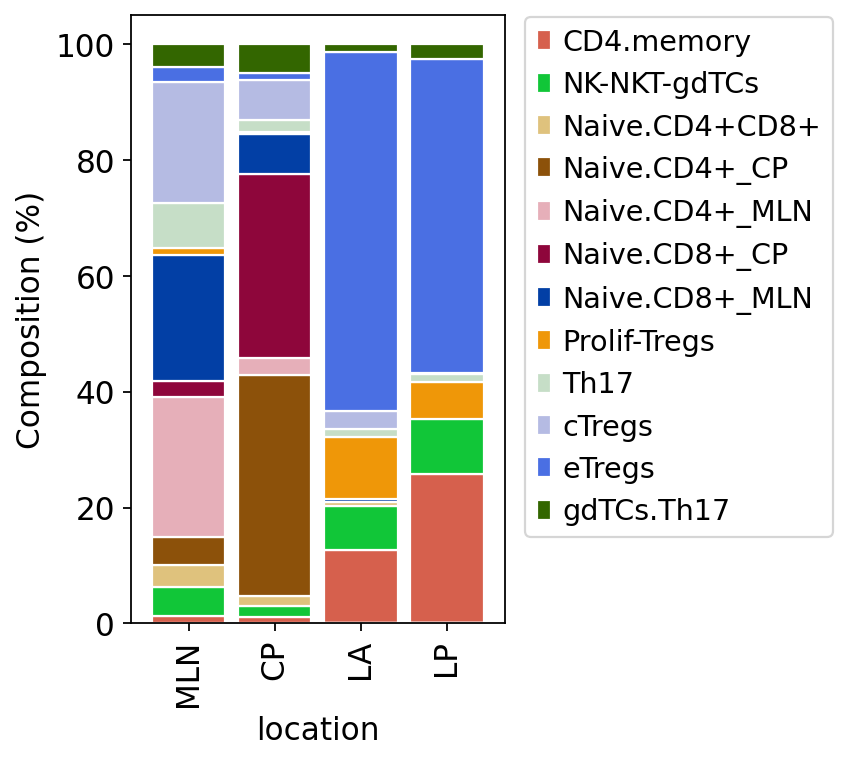

In [38]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp2 = pd.crosstab(adata_TCs.obs['location'], adata_TCs.obs['cell_subset_new'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot2=tmp2.reindex(sort_mapping.index)
    plot2.plot(kind='bar', stacked=True, color= adata_TCs.uns['cell_subset_new_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/TC-only_bar_final.pdf', format='pdf')

In [39]:
tmp2.T.to_csv("SuppFig3A_Barplot_Tcells.csv")

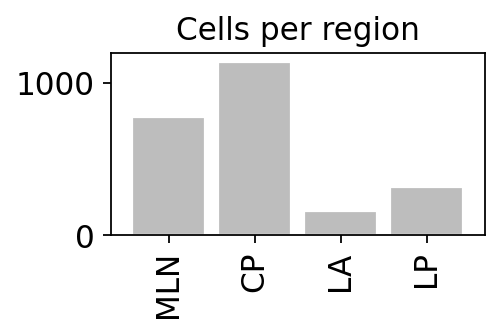

In [40]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp3 =adata_TCs.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot3=tmp3.reindex(sort_mapping.index)
    plot3.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/TC-only_cells_final.pdf', format='pdf')

In [41]:
tmp3

CP     1140
MLN     777
LP      314
LA      158
Name: location, dtype: int64

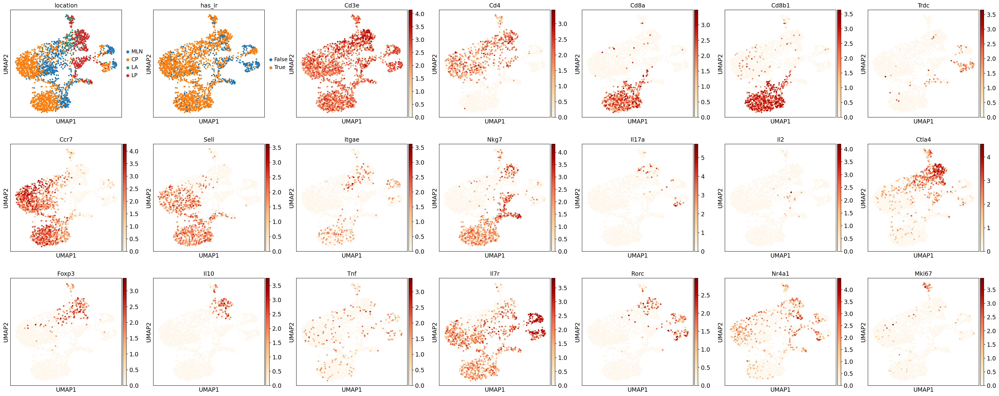

In [42]:
with mpl.rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata_TCs, color = ['location', 'has_ir','Cd3e','Cd4','Cd8a','Cd8b1','Trdc','Ccr7','Sell','Itgae','Nkg7','Il17a','Il2','Ctla4',
                                  'Foxp3','Il10','Tnf','Il7r','Rorc','Nr4a1','Mki67'], ncols=7)

In [43]:
sc.tl.rank_genes_groups(adata_TCs, 'cell_subset_new', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_subset_new']`


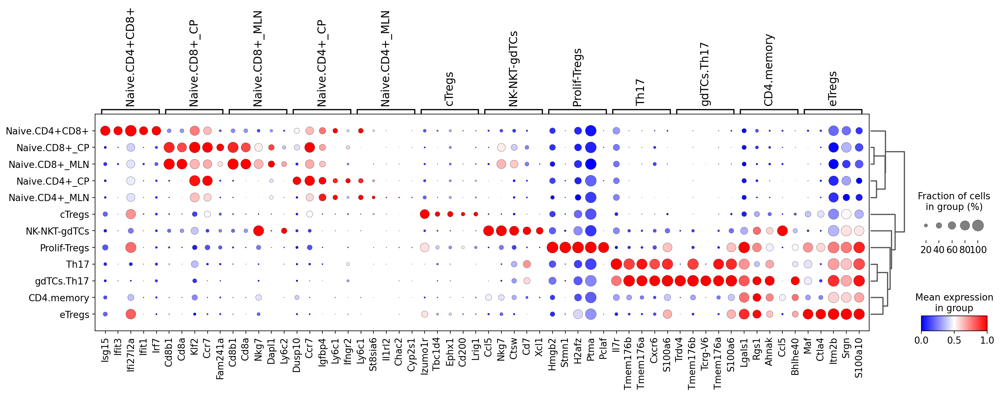

In [44]:
sc.pl.rank_genes_groups_dotplot(adata_TCs, n_genes=5, min_logfoldchange=2, cmap='bwr',figsize=(20,5),standard_scale='var')

In [45]:
de_TCs = find_marker_genes(adata_TCs)

In [46]:
de_TCs.to_csv('GEtable_markers-TCs.csv', header=True, index=False)

## Tregs susbsets  (Fig.2f)

In [47]:
adata_Tregs=sc.read(path+'/h5ad_files/Treg_object_new.h5ad')

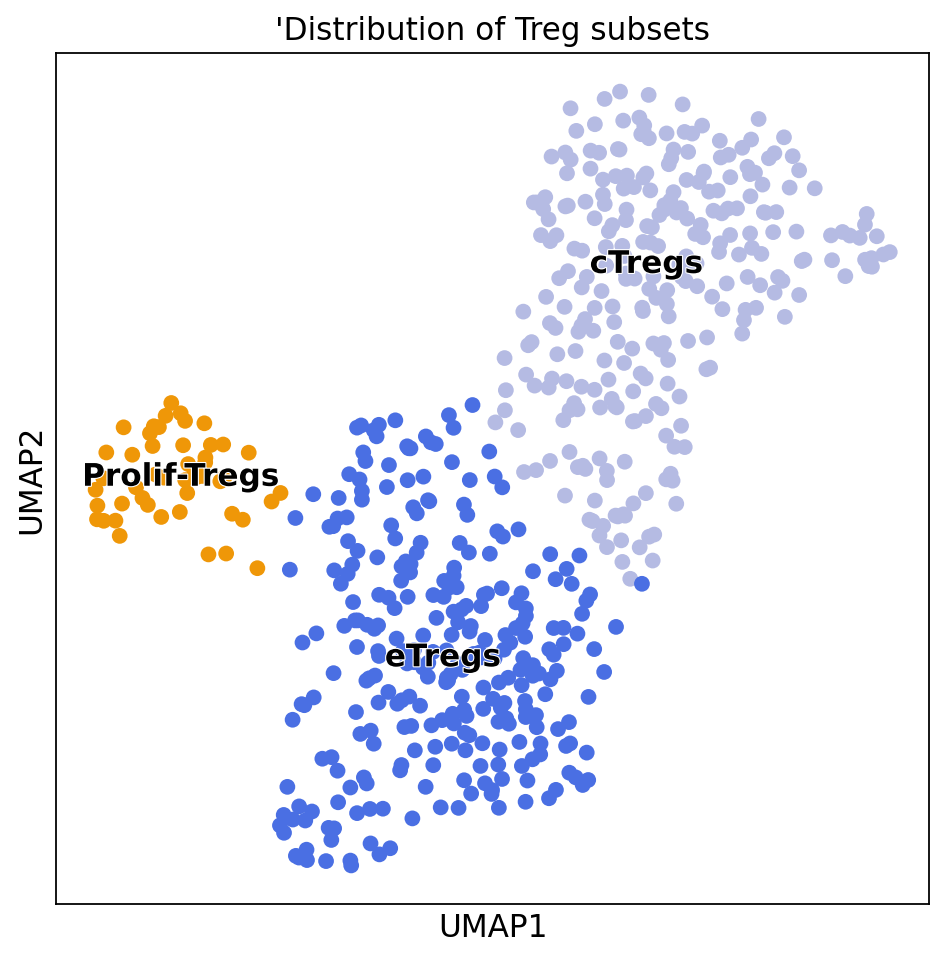

In [48]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_Tregs, color = ['cell_subset'], title="'Distribution of Treg subsets",  
               palette= {
                'eTregs':'#4a6fe3',
                'cTregs': '#b5bbe3',
                'Prolif-Tregs':'#ef9708'},frameon=True, legend_fontsize=14, legend_fontoutline=1, 
               #save='UmapTregs_correctColors.pdf"',
               legend_loc='on data')

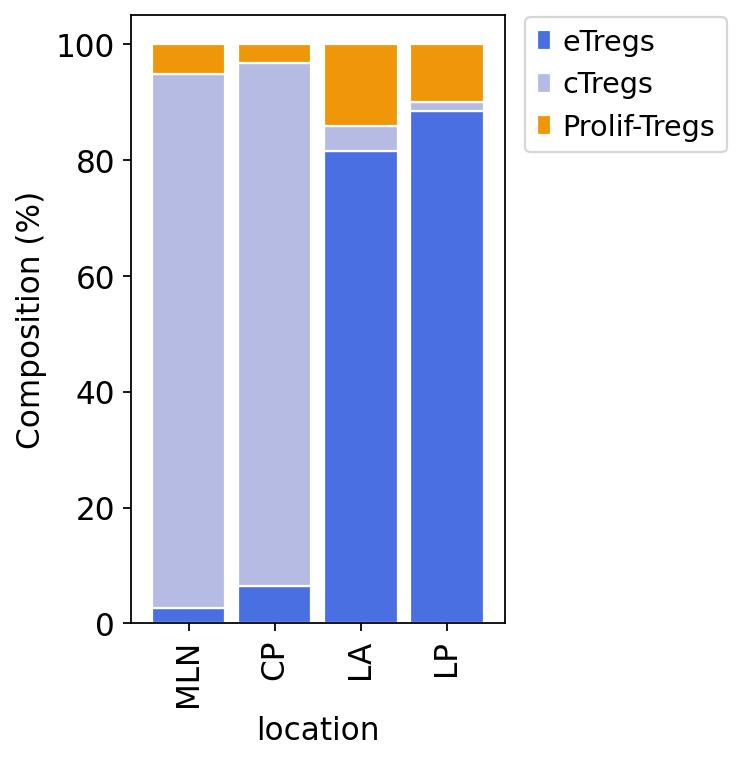

In [49]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp4 = pd.crosstab(adata_Tregs.obs['location'], adata_Tregs.obs['cell_subset'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot4=tmp4.reindex(sort_mapping.index)
    plot4.plot(kind='bar', stacked=True, color= adata_Tregs.uns['cell_subset_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/Tregs_correctColors_bars.pdf', format='pdf')

In [50]:
tmp4.T.to_csv("Fig2F_Barplot_Tregs.csv")

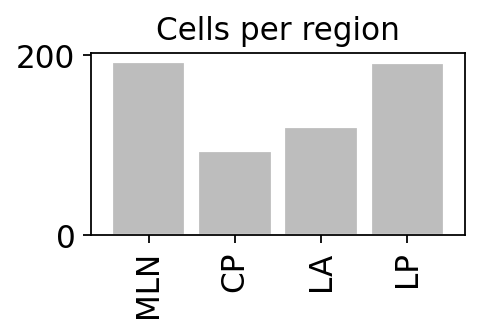

In [51]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp5 =adata_Tregs.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot5=tmp5.reindex(sort_mapping.index)
    plot5.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/Tregs_correctColors_Cells.pdf', format='pdf')

In [52]:
tmp5

MLN    193
LP     191
LA     120
CP      94
Name: location, dtype: int64

### Markers to show in Fig.2f (response to Reviewer 1, resubmission 2)

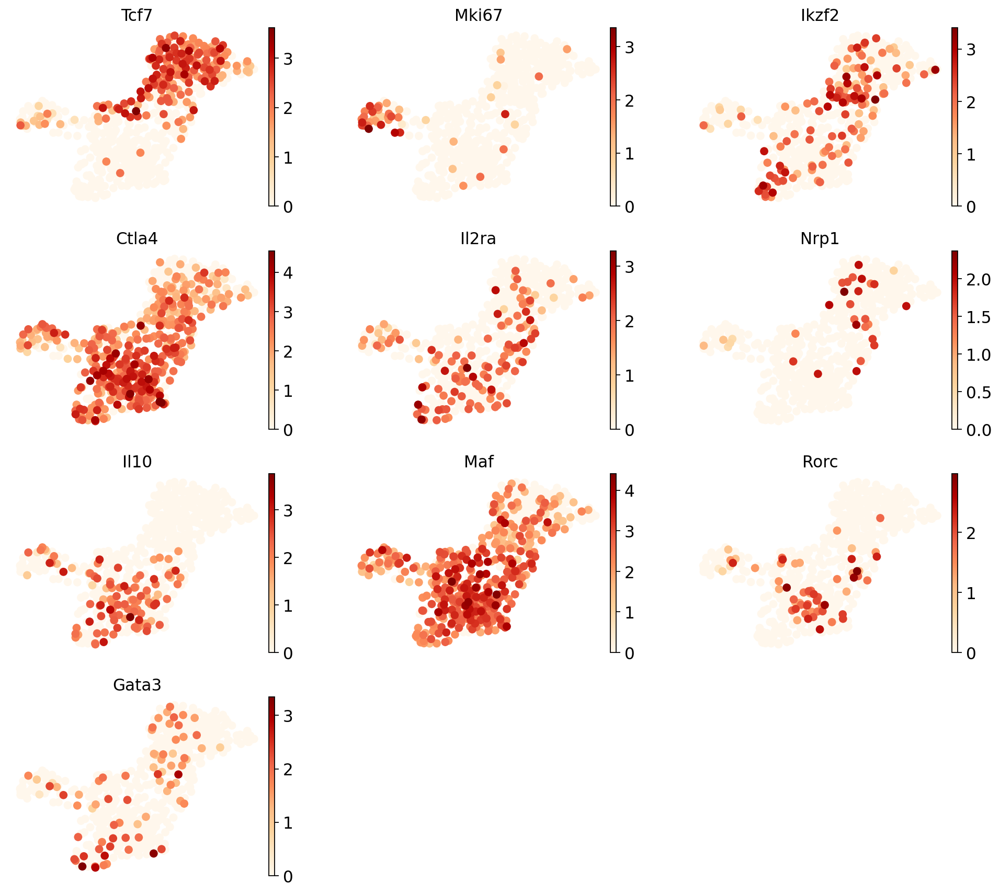

In [53]:
with mpl.rc_context({'figure.figsize': (4, 3)}):
    sc.pl.umap(adata_Tregs, color=['Tcf7','Mki67', 'Ikzf2', 'Ctla4', 'Il2ra','Nrp1', 'Il10','Maf', 'Rorc','Gata3',], legend_loc='on data',
    frameon=False, legend_fontsize=12 ,color_map='OrRd', legend_fontoutline=2, ncols=3)

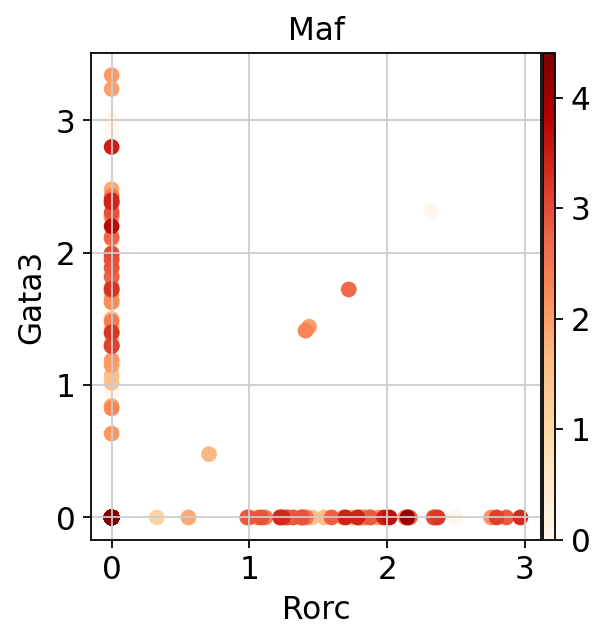

In [54]:
sc.pl.scatter(adata_Tregs, x='Rorc', y='Gata3', color='Maf')#color="location"

### Removing ribosomal and MT genes for GE analysis

In [55]:
Tregs2 = adata_TCs[adata_TCs.obs["cell_subset"].isin(['eTregs','cTregs','Prolif-Tregs'])]
adata_Tregs2 = sc.AnnData(Tregs2.raw.X)
adata_Tregs2.obs = Tregs2.obs
adata_Tregs2.var = Tregs2.raw.var

In [56]:
#List of mouse Rb proteins was downloaded from
Ribo_genes = [x.strip() for x in open('/home/jovyan/Miscelanea/Gene_lists/Mouse_Rb_proteins_geneList_ribosome.med.miyazaki-u.ac.jp.txt')]
RBgenes = [x for x in Ribo_genes if x in adata_Tregs2.var_names]
print(RBgenes)

['Rpsa', 'Rps2', 'Rps3', 'Rps4x', 'Rps5', 'Rps6', 'Rps7', 'Rps8', 'Rps9', 'Rps10', 'Rps11', 'Rps12', 'Rps13', 'Rps14', 'Rps15', 'Rps15a', 'Rps16', 'Rps17', 'Rps18', 'Rps19', 'Rps20', 'Rps21', 'Rps23', 'Rps24', 'Rps25', 'Rps26', 'Rps27', 'Rps27a', 'Rps28', 'Rps29', 'Rpl3', 'Rpl4', 'Rpl5', 'Rpl6', 'Rpl7', 'Rpl7a', 'Rpl8', 'Rpl9', 'Rpl10', 'Rpl10a', 'Rpl11', 'Rpl12', 'Rpl13', 'Rpl13a', 'Rpl14', 'Rpl15', 'Rpl17', 'Rpl18', 'Rpl18a', 'Rpl19', 'Rpl21', 'Rpl22', 'Rpl23', 'Rpl23a', 'Rpl24', 'Rpl26', 'Rpl27', 'Rpl27a', 'Rpl28', 'Rpl29', 'Rpl30', 'Rpl31', 'Rpl32', 'Rpl34', 'Rpl35', 'Rpl35a', 'Rpl36', 'Rpl37', 'Rpl37a', 'Rpl38', 'Rpl39', 'Rpl41', 'Rplp0', 'Rplp1', 'Rplp2']


In [57]:
Mt_genes = list(adata_Tregs2.var_names[adata_Tregs2.var_names.str.startswith('mt-')])
Mt_genes[1:10]

['mt-Nd2',
 'mt-Co1',
 'mt-Co2',
 'mt-Atp8',
 'mt-Atp6',
 'mt-Co3',
 'mt-Nd3',
 'mt-Nd4l',
 'mt-Nd4']

In [58]:
#RMgenes_list = [y for x in [RBgenes, Gm_genes] for y in x]
RMgenes_list = [y for x in [RBgenes, Mt_genes] for y in x]

In [59]:
#print(RMgenes_list)

In [60]:
# read in list of ribo genes from kegg (HUMAN RB)
#ribo_url = "http://software.broadinstitute.org/gsea/msigdb/download_geneset.jsp?geneSetName=KEGG_RIBOSOME&fileType=txt" 
#ribo_genes = pd.read_table( ribo_url, header=[1])
#ribo_genes = adata.var_names.str.startswith(('Rps','Rpl'))
# create mask for all ribo genes
ribo_mk = np.in1d(adata_Tregs2.var_names.values.astype(str), RMgenes_list)
adata_TregClean = adata_Tregs2[:,~ribo_mk]

In [61]:
adata_TregClean.var

,gene_ids,mt,rb,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
Sox17,Sox17,False,False,221,0.026731,98.718023,460.818756,221,True,0.131385,2.748144,2.592534
Mrpl15,Mrpl15,False,False,3218,0.297666,81.333024,5131.465332,3218,False,0.480022,1.226943,-0.471321
Lypla1,Lypla1,False,False,2460,0.188250,85.730031,3245.247803,2460,False,0.353775,1.208837,-0.495850
Tcea1,Tcea1,False,False,6241,0.829154,63.797204,14293.792969,6241,False,1.043117,1.383716,-0.455413
Rgs20,Rgs20,False,False,3,0.000174,99.982598,2.995511,3,False,0.000562,1.542446,0.282720
...,...,...,...,...,...,...,...,...,...,...,...,...
CR974586.2,CR974586.2,False,False,67,0.007599,99.611346,131.000000,67,False,0.017431,1.512446,0.225248
CR974586.4,CR974586.4,False,False,237,0.042484,98.625210,732.385132,237,True,0.101700,2.757137,2.609761
Ccl21a.1,Ccl21a.1,False,False,30,0.002436,99.825976,42.000000,30,False,0.008137,1.713661,0.610724
CAAA01147332.1,CAAA01147332.1,False,False,1400,0.095975,91.878879,1654.511108,1400,False,0.240455,1.431409,0.070001


In [62]:
sc.pp.highly_variable_genes(adata_TregClean, min_mean=0.0125, max_mean=3, min_disp=0.5,subset=False)
print(adata_TregClean.var.highly_variable.sum())
#Actually do the filtering.
adata_TregClean = adata_TregClean[:, adata_TregClean.var.highly_variable]

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
2707


In [63]:
sc.pp.scale(adata_TregClean, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [64]:
sc.tl.rank_genes_groups(adata_TregClean, groupby='cell_subset', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [65]:
adata_TregClean.uns['cell_subset_colors']=['#4a6fe3','#b5bbe3','#ef9708']

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:00)
Storing dendrogram info using `.uns['dendrogram_cell_subset']`


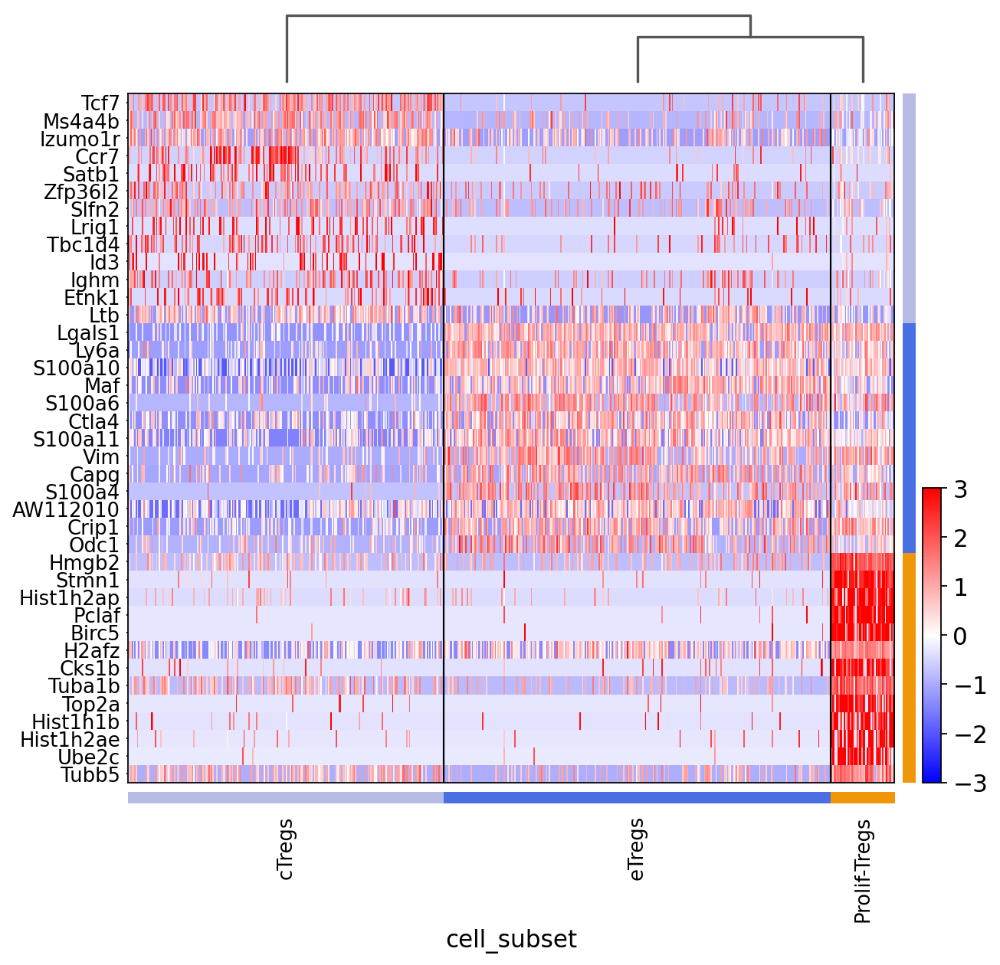

In [66]:
sc.pl.rank_genes_groups_heatmap(adata_TregClean, n_genes=13, swap_axes=True, vmin=-3, vmax=3, cmap='bwr', figsize=(8.5,8.5), show=True)

## ILCs  (SuppFig.3b)

In [67]:
adata_ILCs=sc.read(path+'/h5ad_files/ILCs.h5ad')

In [68]:
adata_ILCs.obs['cell_subset'].value_counts()

ILC3s.Rorgt+            167
ILC2s                    74
LTi-like.ILC3s           45
ILC3s.Rorgt+.MHCIIhi     23
Name: cell_subset, dtype: int64

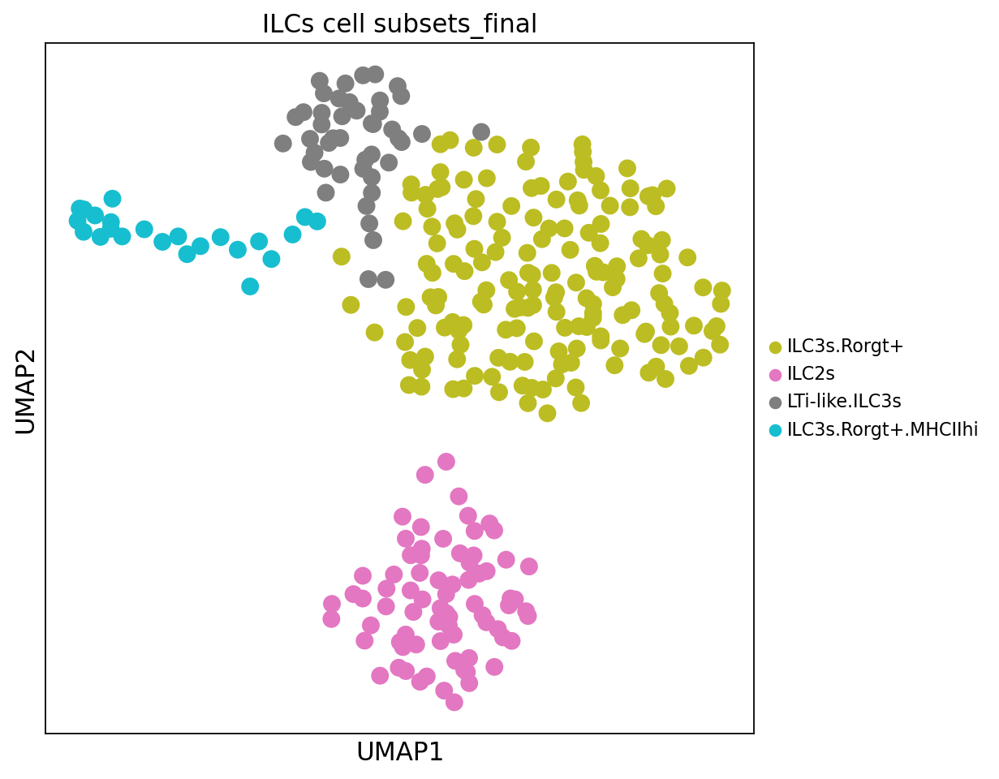

In [69]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_ILCs, color=['cell_subset'],
             title= 'ILCs cell subsets_final',
               legend_fontsize=10, legend_fontoutline=1)

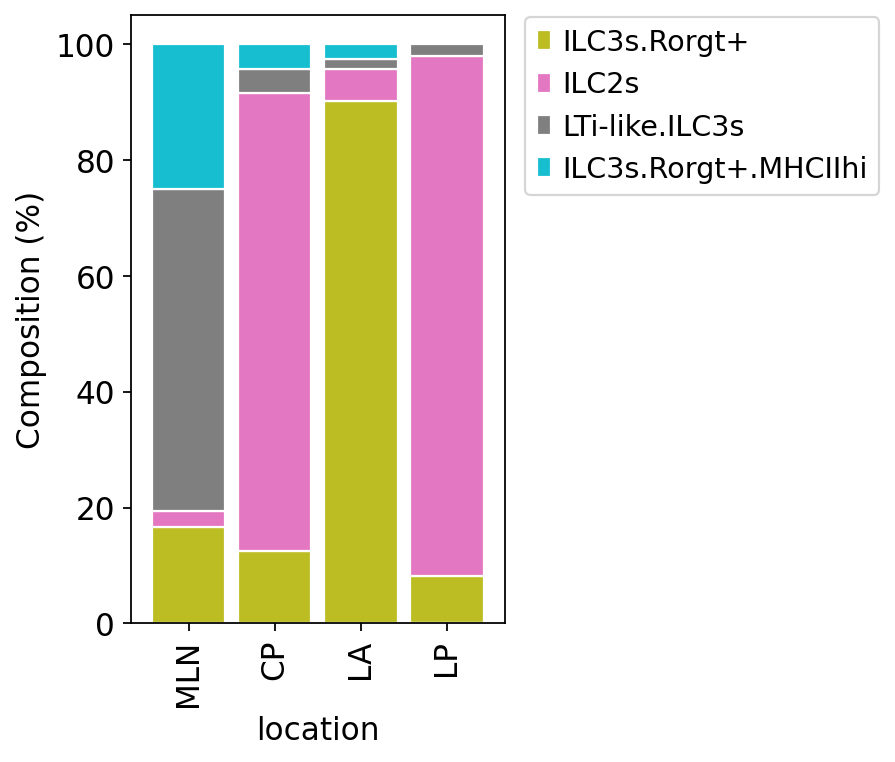

In [70]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp6 = pd.crosstab(adata_ILCs.obs['location'], adata_ILCs.obs['cell_subset'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot6=tmp6.reindex(sort_mapping.index)
    plot6.plot(kind='bar', stacked=True, color= adata_ILCs.uns['cell_subset_colors'],edgecolor='white', width=0.85,ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/ILCs_bar_final.pdf', format='pdf')

In [169]:
tmp6.T.to_csv("SuppFig3B_Barplot_ILCs.csv")

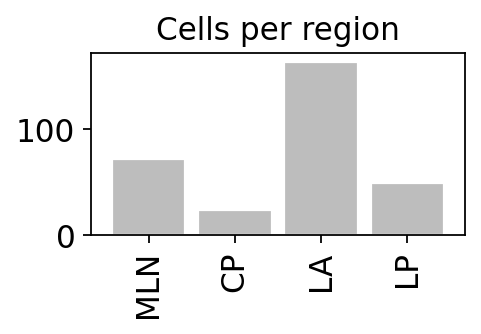

In [171]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp7 =adata_ILCs.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot7=tmp7.reindex(sort_mapping.index)
    plot7.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/ILCs_cells.pdf', format='pdf')

In [172]:
tmp7

LA     164
MLN     72
LP      49
CP      24
Name: location, dtype: int64

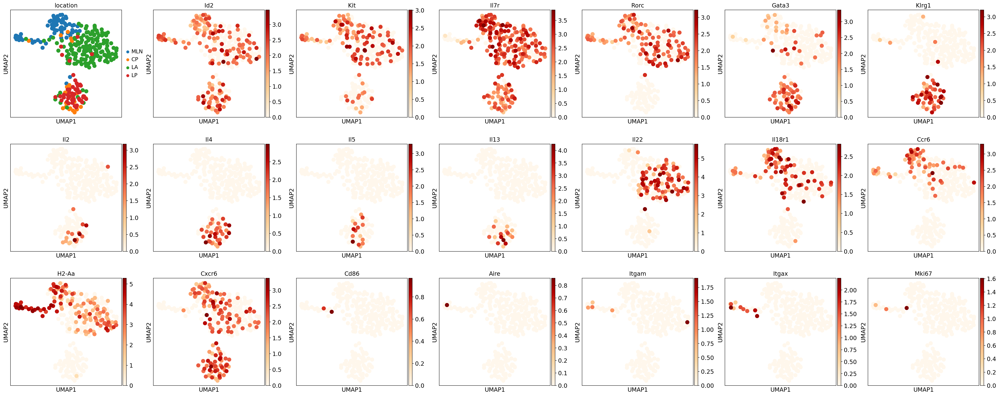

In [73]:
with mpl.rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata_ILCs, color=['location','Id2','Kit','Il7r','Rorc','Gata3','Klrg1','Il2','Il4','Il5','Il13','Il22','Il18r1','Ccr6','H2-Aa','Cxcr6','Cd86','Aire','Itgam','Itgax','Mki67'],
               ncols=7)

In [74]:
sc.tl.rank_genes_groups(adata_ILCs, groupby='cell_subset', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


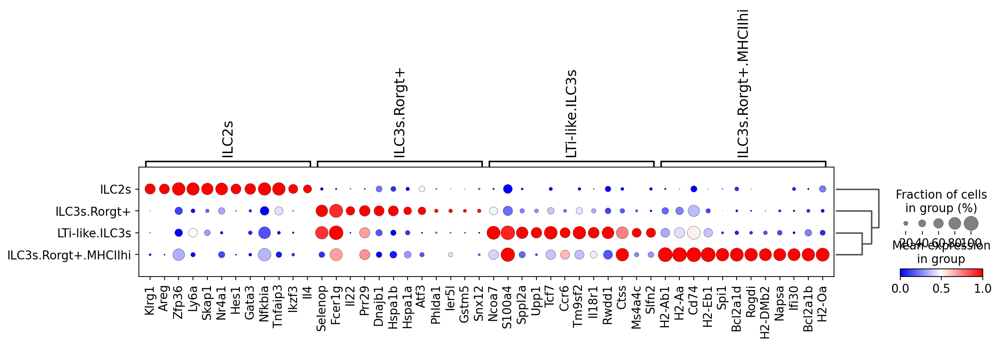

In [75]:
sc.pl.rank_genes_groups_dotplot(adata_ILCs, n_genes=12, min_logfoldchange=2, cmap='bwr',figsize=(15,2),standard_scale='var')

In [76]:
de_ILCs = find_marker_genes(adata_ILCs)

In [77]:
de_ILCs.to_csv('GEtable_markers-ILCs.csv', header=True, index=False)

### MHC-II score, CD80 and CD86 violin plots in SuppFig.3

In [154]:
sc.tl.score_genes(adata_ILCs, sMHCII_genes, score_name='sMHCII_score')

computing score 'sMHCII_score'
    finished: added
    'sMHCII_score', score of gene set (adata.obs).
    299 total control genes are used. (0:00:00)


In [155]:
adata_ILCs.obs['cellsubsetLoc']= adata_ILCs.obs.astype(str)['cell_subset'] +'_'+ adata_ILCs.obs.astype(str)["location"]

In [156]:
adata_ILCs.obs['cellsubsetLoc'] = pd.Categorical(adata_ILCs.obs['cellsubsetLoc'])

In [157]:
#Filter cell types with less than 10 cells in each gut location
adata_fILCs = adata_ILCs[adata_ILCs.obs['cellsubsetLoc'].map(adata_ILCs.obs['cellsubsetLoc'].value_counts())>10]

In [159]:
adata_fILCs.uns['cellsubsetLoc_colors']=['#e377c2', '#e377c2', '#17becf','#bcbd22' ,'#bcbd22' , '#7f7f7f']

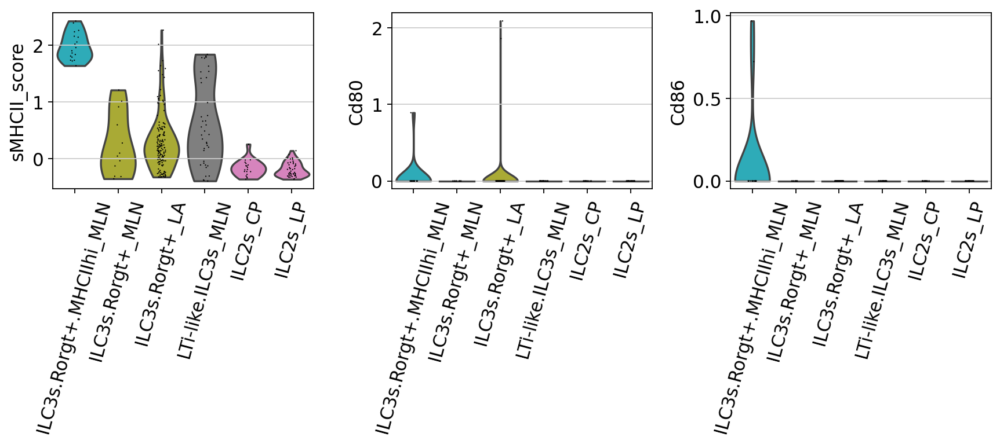

In [161]:
with rc_context({'figure.figsize': (4, 2.5)}):
    sc.pl.violin(adata_fILCs, [ 'sMHCII_score','Cd80','Cd86'], order=['ILC3s.Rorgt+.MHCIIhi_MLN','ILC3s.Rorgt+_MLN','ILC3s.Rorgt+_LA','LTi-like.ILC3s_MLN','ILC2s_CP','ILC2s_LP'], groupby='cellsubsetLoc',rotation=75)

## B cells and PCs  (SuppFig.4a)

In [85]:
adata_BCs=sc.read(path+'/h5ad_files/BCs-PCs_clean_finalLabels.h5ad')

In [86]:
adata_BCs

AnnData object with n_obs × n_vars = 3912 × 1882
    obs: 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', 'IR_VJ_2_v_gene', 'IR_VDJ_1_v_gene', 'IR_VDJ_2_v_gene', 'IR_VJ_1_d_gene', 'IR_VJ_2_d_gene', 'IR_VDJ_1_d_gene', 'IR_VDJ_2_d_gene', 'IR_VJ_1_j_gene', 'IR_VJ_2_j_gene', 'IR_VDJ_1_j_gene', 'IR_VDJ_2_j_gene', 'IR_VJ_1_c_gene', 'IR_VJ_2_c_gene', 'IR_VDJ_1_c_gene', 'IR_VDJ_2_c_gene', 'IR_VJ_1_junction_ins', 'IR_VJ_2_junction_ins', 'IR_VDJ_1_junction_ins', 'IR_VDJ_2_junction_ins', 'has_ir', 'multi_chain', 'sample', 'location', 'batch', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'predicted_doublets', 'n_genes_b

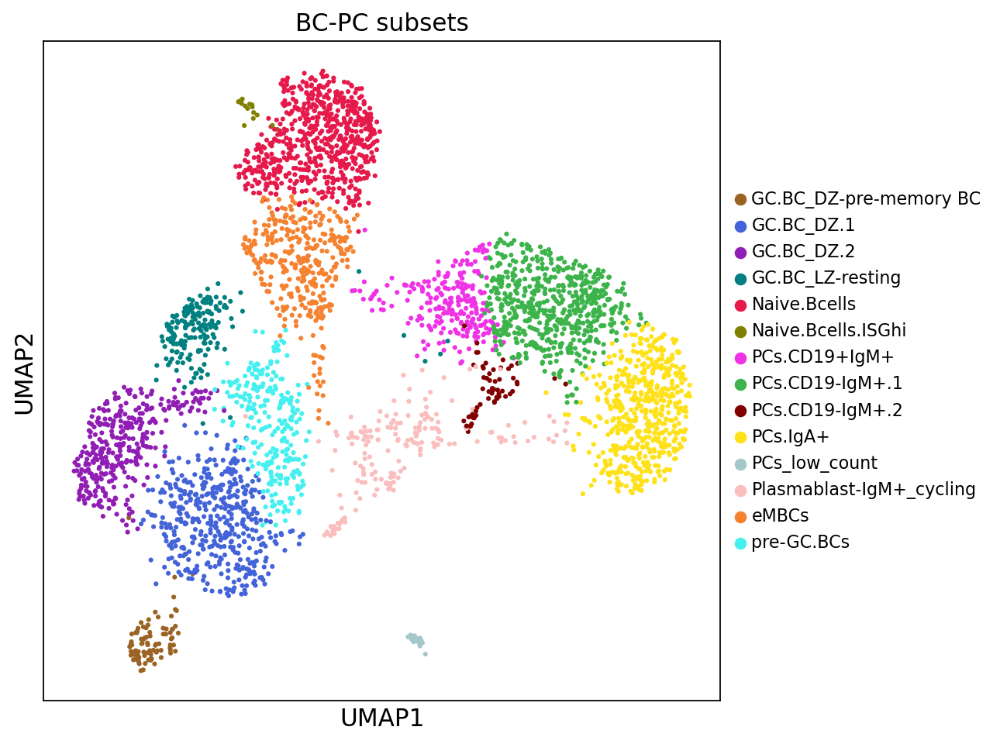

In [87]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_BCs, color=['cell_subset_new'], save="BC-PC_umap_woDoublets_final.pdf", title= 'BC-PC subsets',
                palette={'Naive.Bcells': '#e6194b',
                     'PCs.CD19-IgM+.1': '#3cb44b',
                     'PCs.IgA+': '#ffe119',
                     'GC.BC_DZ.1': '#4363d8',
                     'eMBCs': '#f58231',
                     'GC.BC_DZ.2': '#911eb4',
                     'pre-GC.BCs': '#46f0f0',
                     'PCs.CD19+IgM+': '#f032e6',
                     'Plasmablast-IgM+_cycling': '#fabebe',
                     'GC.BC_LZ-resting': '#008080',
                     'GC.BC_DZ-pre-memory BC': '#9a6324',
                     'PCs.CD19-IgM+.2': '#800000',
                     'Naive.Bcells.ISGhi': '#808000',
                     'PCs_low_count':'#A4C8CA'},
               legend_fontsize=10, legend_fontoutline=1)


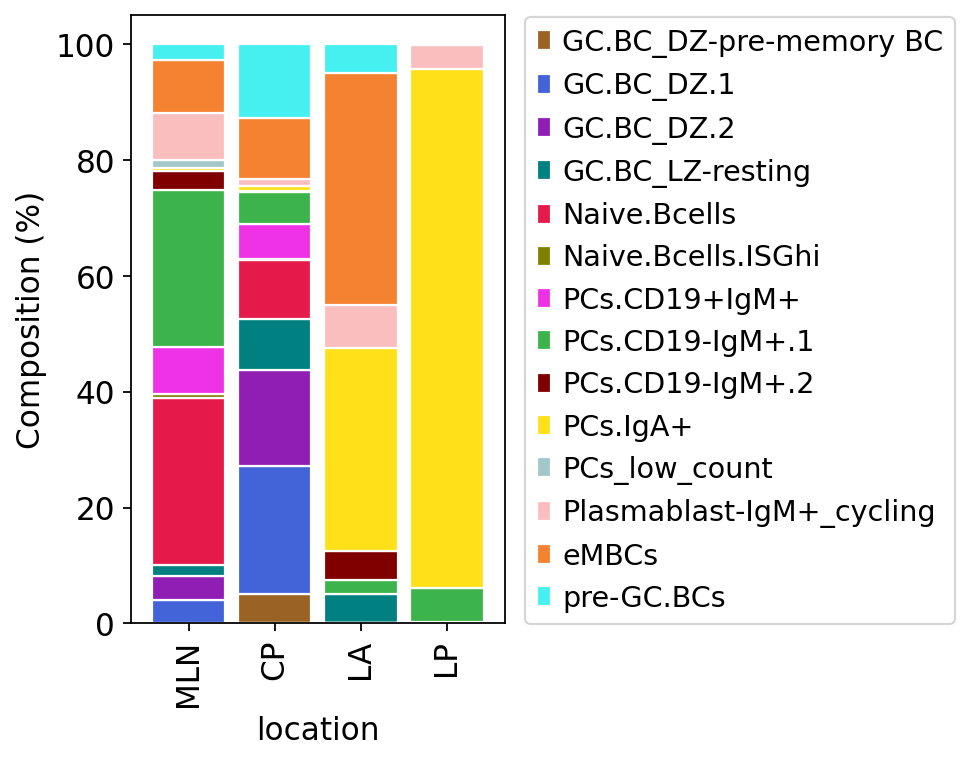

In [90]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp7 = pd.crosstab(adata_BCs.obs['location'], adata_BCs.obs['cell_subset_new'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot7=tmp7.reindex(sort_mapping.index)
    plot7.plot(kind='bar', stacked=True, color= adata_BCs.uns['cell_subset_new_colors'],edgecolor='white', width=0.85,ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/BCs_woDoublets_bar_final.pdf', format='pdf')

In [98]:
tmp7.T.to_csv("SuppFig4B_Barplot_BCs.csv")

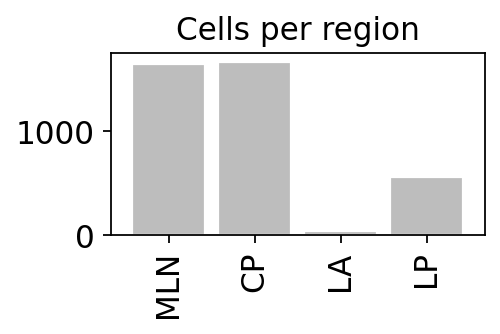

In [93]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp8 =adata_BCs.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot8=tmp8.reindex(sort_mapping.index)
    plot8.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/BCs_woDoublets_loc_final.pdf', format='pdf')

In [94]:
tmp8

CP     1667
MLN    1648
LP      557
LA       40
Name: location, dtype: int64

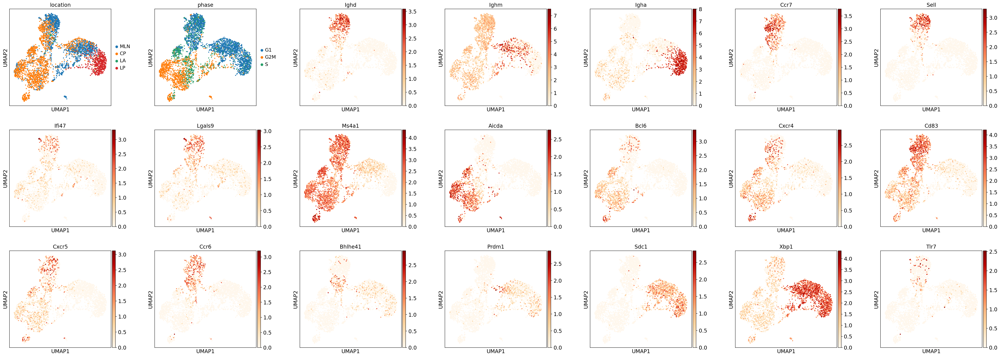

In [95]:
with mpl.rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata_BCs, color=['location','phase','Ighd','Ighm','Igha','Ccr7','Sell','Ifi47', 'Lgals9',
                                 'Ms4a1','Aicda','Bcl6','Cxcr4','Cd83','Cxcr5','Ccr6','Bhlhe41','Prdm1','Sdc1',
                                 'Xbp1','Tlr7'],ncols=7, wspace=0.3)

In [96]:
sc.tl.rank_genes_groups(adata_BCs, groupby='cell_subset_new', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_subset_new']`


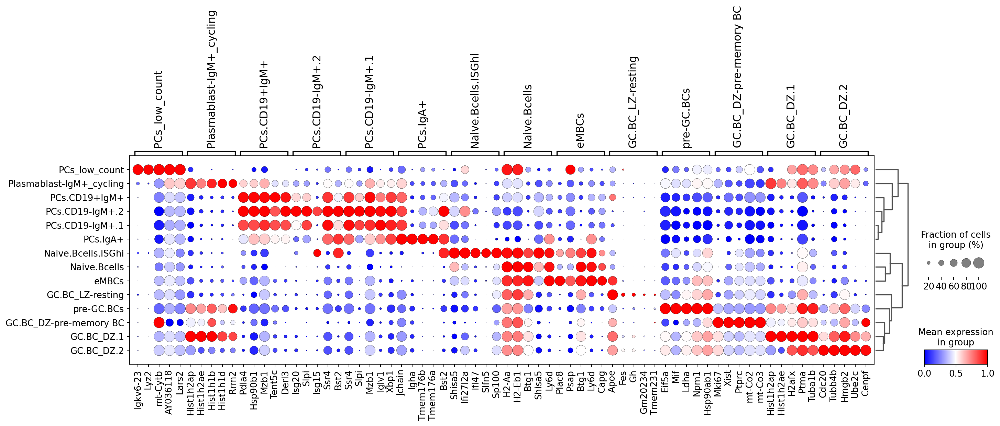

In [97]:
sc.pl.rank_genes_groups_dotplot(adata_BCs, n_genes=5, min_logfoldchange=2.5, cmap='bwr',figsize=(20,5),standard_scale='var')

In [99]:
de_BCs = find_marker_genes(adata_BCs)

In [100]:
de_BCs.to_csv('GEtable_markers-BCs.csv', header=True, index=False)

## Total Myeloid  (Fig.4a)

In [115]:
adata_Mye=sc.read(path+"/h5ad_files/Mye_Clean_object.h5ad")

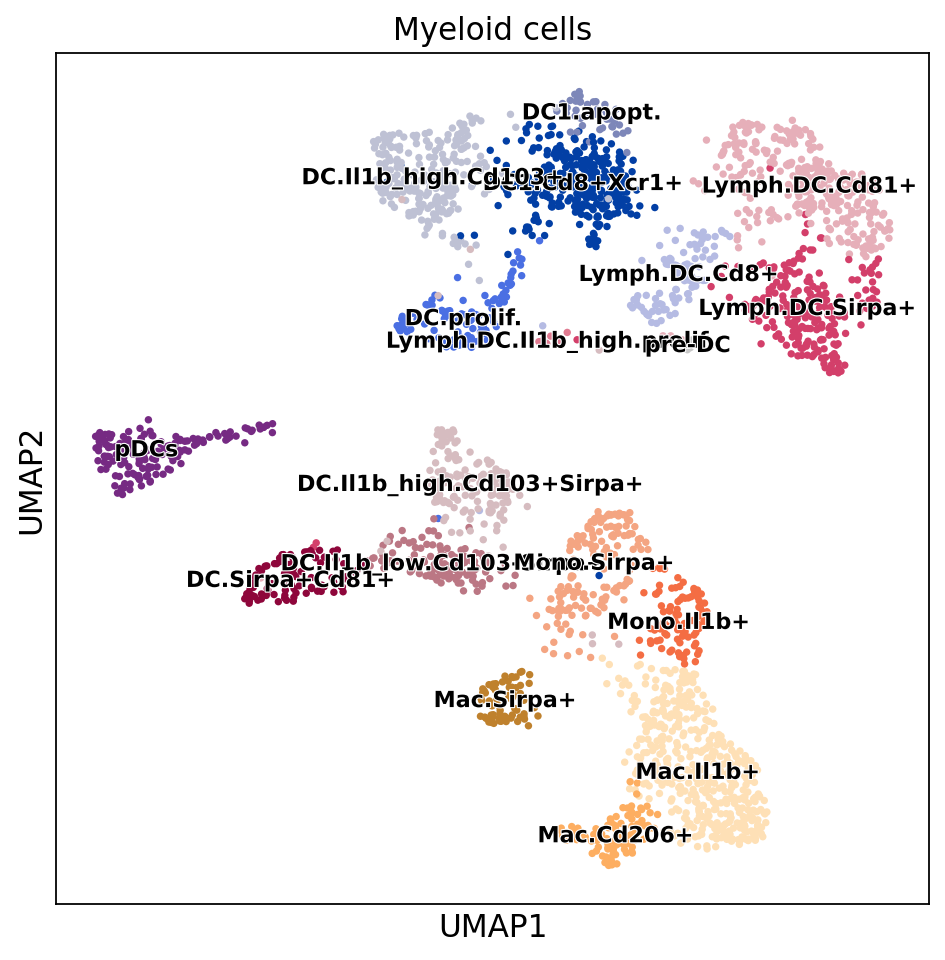

In [116]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_Mye, color = ['cell_subset_int'], title="Myeloid cells",  
            frameon=True, legend_fontsize=10, legend_fontoutline=1, legend_loc="on data")

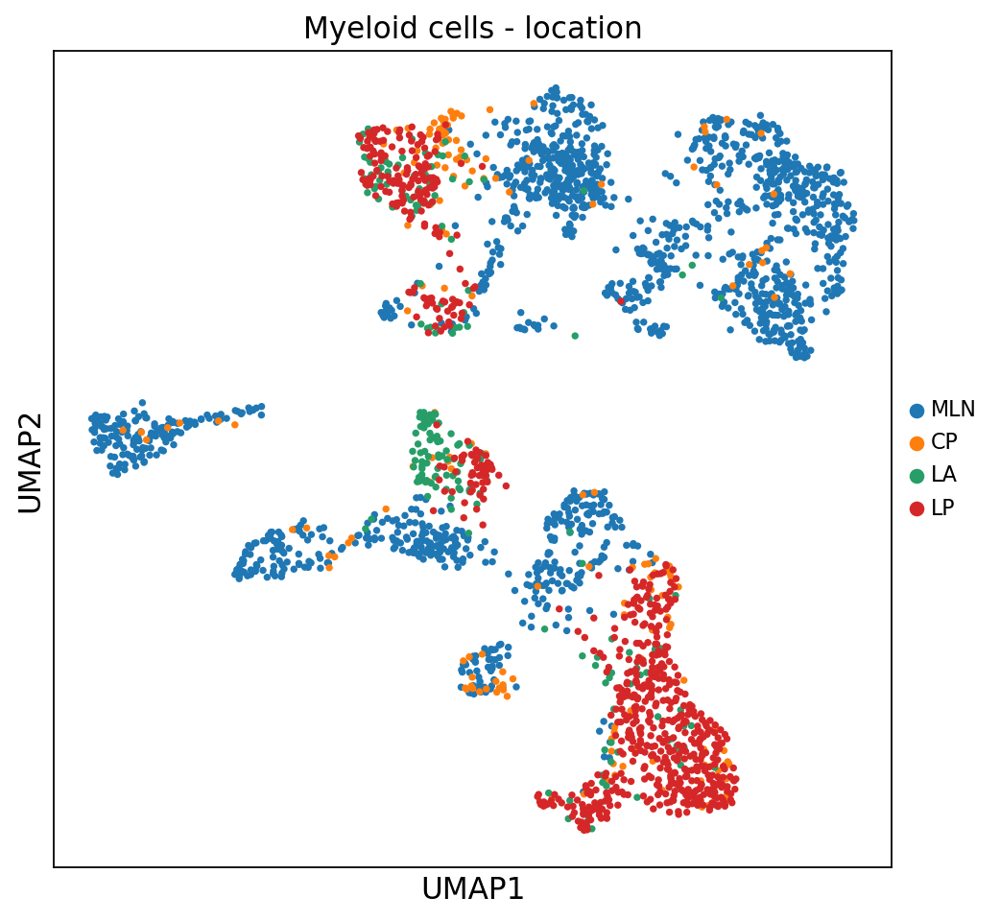

In [117]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_Mye, color = ['location'], title="Myeloid cells - location",  
            frameon=True, legend_fontsize=10, legend_fontoutline=1)

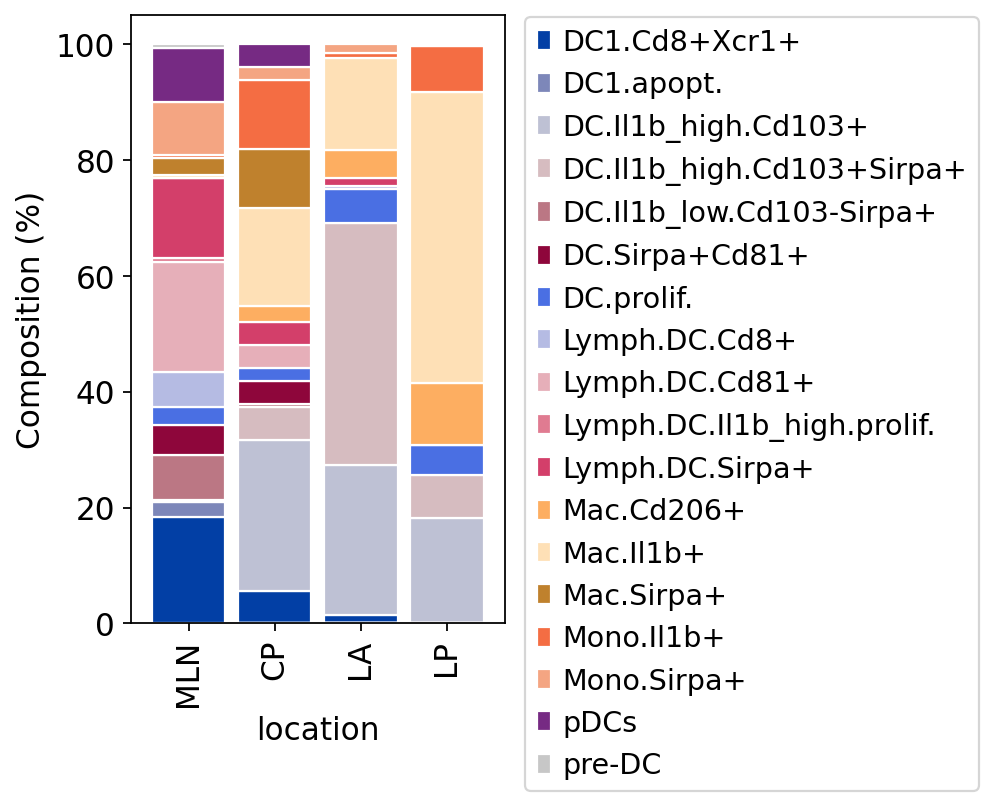

In [118]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp9 = pd.crosstab(adata_Mye.obs['location'], adata_Mye.obs['cell_subset_int'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot9=tmp9.reindex(sort_mapping.index)
    plot9.plot(kind='bar', stacked=True, color= adata_Mye.uns['cell_subset_int_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/Myeloid_UMAPcorrectColors_bars.pdf', format='pdf')

In [119]:
tmp9.T.to_csv("Fig4A_Barplot_Mye.csv")

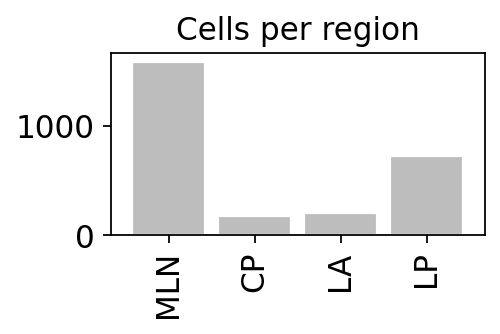

In [120]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp10 =adata_Mye.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot10=tmp10.reindex(sort_mapping.index)
    plot10.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig('/nfs/team205/rb29/mice_gutTCRtg_project/Src/Mice-gut.TCRtg/new_analysis/figures/Myeloid_UMAPcorrectColors_Cells.pdf', format='pdf')

In [121]:
tmp10

MLN    1586
LP      722
LA      208
CP      177
Name: location, dtype: int64

In [122]:
sc.tl.rank_genes_groups(adata_Mye, groupby='cell_subset_int', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


In [123]:
de_Mye = find_marker_genes(adata_Mye)

In [124]:
de_Mye.to_csv('GEtable_markers-Mye.csv', header=True, index=False)

## Monocyte - Macrophages. (Supp.Fig3c)

In [130]:
adata_MoMac=sc.read(path+"/h5ad_files/MonocyteMac.h5ad")

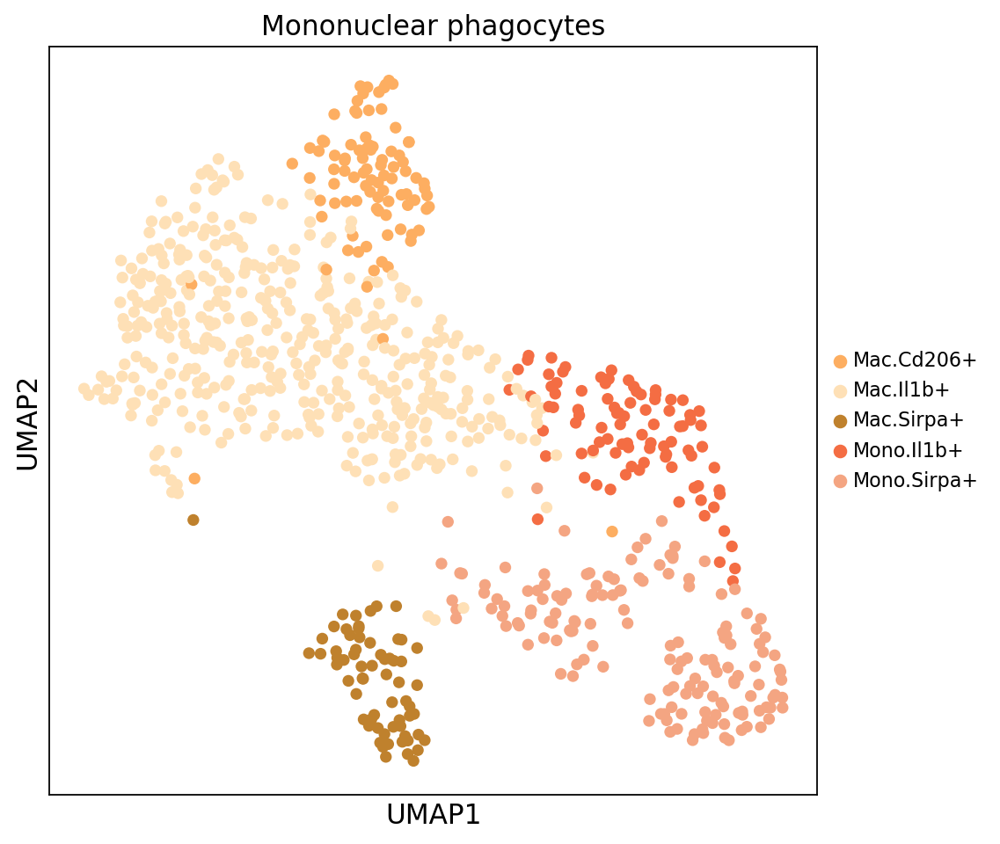

In [131]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_MoMac, color = ['cell_subset'], title="Mononuclear phagocytes",  
            frameon=True, legend_fontsize=10, legend_fontoutline=1)

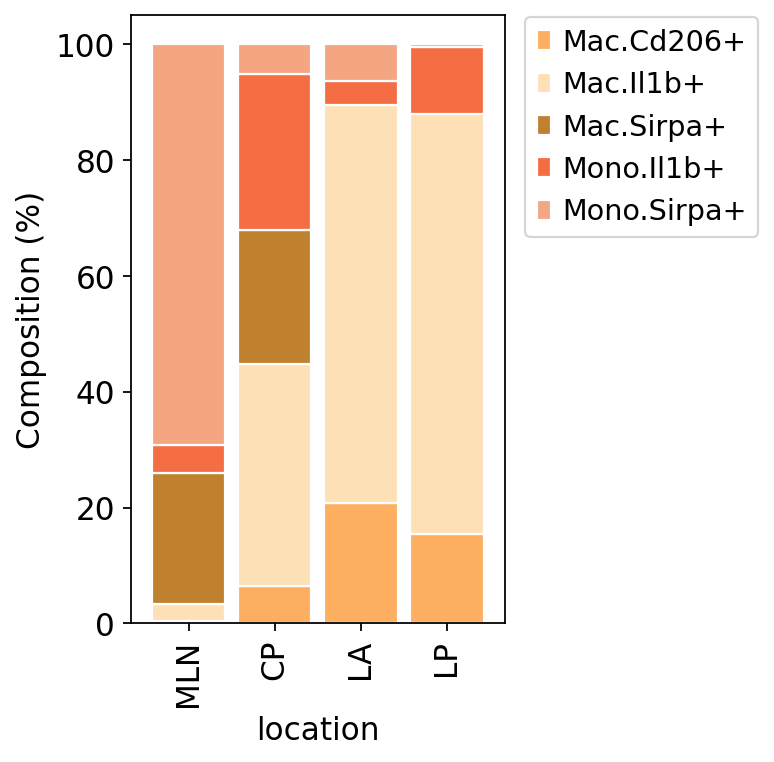

In [132]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp11 = pd.crosstab(adata_MoMac.obs['location'], adata_MoMac.obs['cell_subset'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot11=tmp11.reindex(sort_mapping.index)
    plot11.plot(kind='bar', stacked=True, color= adata_MoMac.uns['cell_subset_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/MonoMac_bars_final.pdf', format='pdf')

In [162]:
tmp11.T.to_csv("SuppFig3C_Barplot_MonoMac.csv")

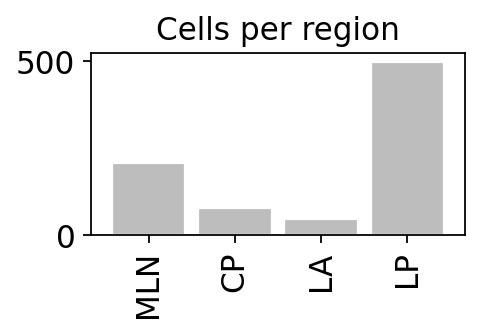

In [163]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp12 =adata_MoMac.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot12=tmp12.reindex(sort_mapping.index)
    plot12.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/Myeloid_UMAPcorrectColors_Cells.pdf', format='pdf')

In [164]:
tmp12

LP     499
MLN    208
CP      78
LA      48
Name: location, dtype: int64

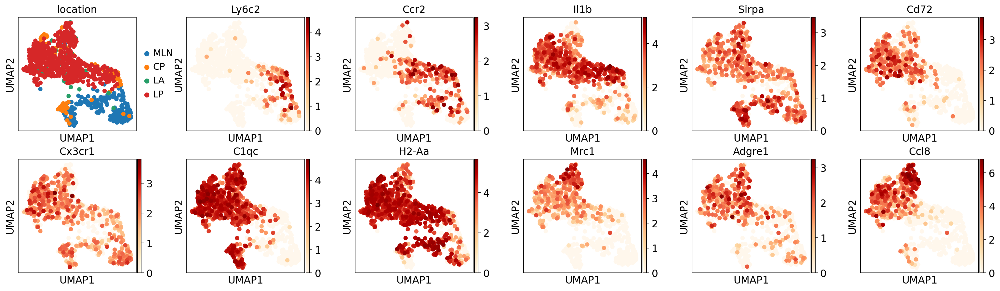

In [165]:
with mpl.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata_MoMac, color=['location','Ly6c2','Ccr2','Il1b','Sirpa', 'Cd72','Cx3cr1','C1qc','H2-Aa','Mrc1','Adgre1','Ccl8'],ncols=6, wspace=0.3)

In [166]:
sc.tl.rank_genes_groups(adata_MoMac, groupby='cell_subset', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


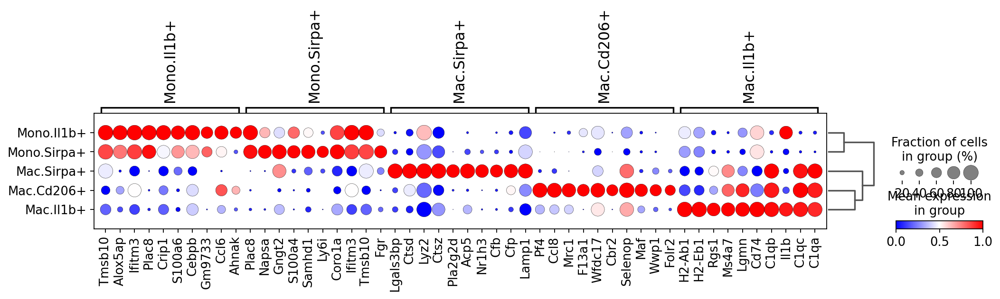

In [137]:
sc.pl.rank_genes_groups_dotplot(adata_MoMac, n_genes=10, min_logfoldchange=2, cmap='bwr',figsize=(15,2),standard_scale='var')

In [167]:
de_MoMac = find_marker_genes(adata_MoMac)

In [168]:
de_MoMac.to_csv('GEtable_markers-MoMac.csv', header=True, index=False)

## Dendritic cells (SuppFig.4a)

In [173]:
adata_DCs=sc.read(path+"/h5ad_files/DCs.h5ad")

In [174]:
adata_DCs

AnnData object with n_obs × n_vars = 1718 × 3001
    obs: 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_cdr3', 'IR_VJ_2_cdr3', 'IR_VDJ_1_cdr3', 'IR_VDJ_2_cdr3', 'IR_VJ_1_cdr3_nt', 'IR_VJ_2_cdr3_nt', 'IR_VDJ_1_cdr3_nt', 'IR_VDJ_2_cdr3_nt', 'IR_VJ_1_expr', 'IR_VJ_2_expr', 'IR_VDJ_1_expr', 'IR_VDJ_2_expr', 'IR_VJ_1_expr_raw', 'IR_VJ_2_expr_raw', 'IR_VDJ_1_expr_raw', 'IR_VDJ_2_expr_raw', 'IR_VJ_1_v_gene', 'IR_VJ_2_v_gene', 'IR_VDJ_1_v_gene', 'IR_VDJ_2_v_gene', 'IR_VJ_1_d_gene', 'IR_VJ_2_d_gene', 'IR_VDJ_1_d_gene', 'IR_VDJ_2_d_gene', 'IR_VJ_1_j_gene', 'IR_VJ_2_j_gene', 'IR_VDJ_1_j_gene', 'IR_VDJ_2_j_gene', 'IR_VJ_1_c_gene', 'IR_VJ_2_c_gene', 'IR_VDJ_1_c_gene', 'IR_VDJ_2_c_gene', 'IR_VJ_1_junction_ins', 'IR_VJ_2_junction_ins', 'IR_VDJ_1_junction_ins', 'IR_VDJ_2_junction_ins', 'has_ir', 'multi_chain', 'sample', 'location', 'batch', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'predicted_doublets', 'n_genes_b

In [175]:
adata_DC = adata_DCs[~adata_DCs.obs["cell_subset"].isin(['Lymph.DC-PC.Doublets'])]

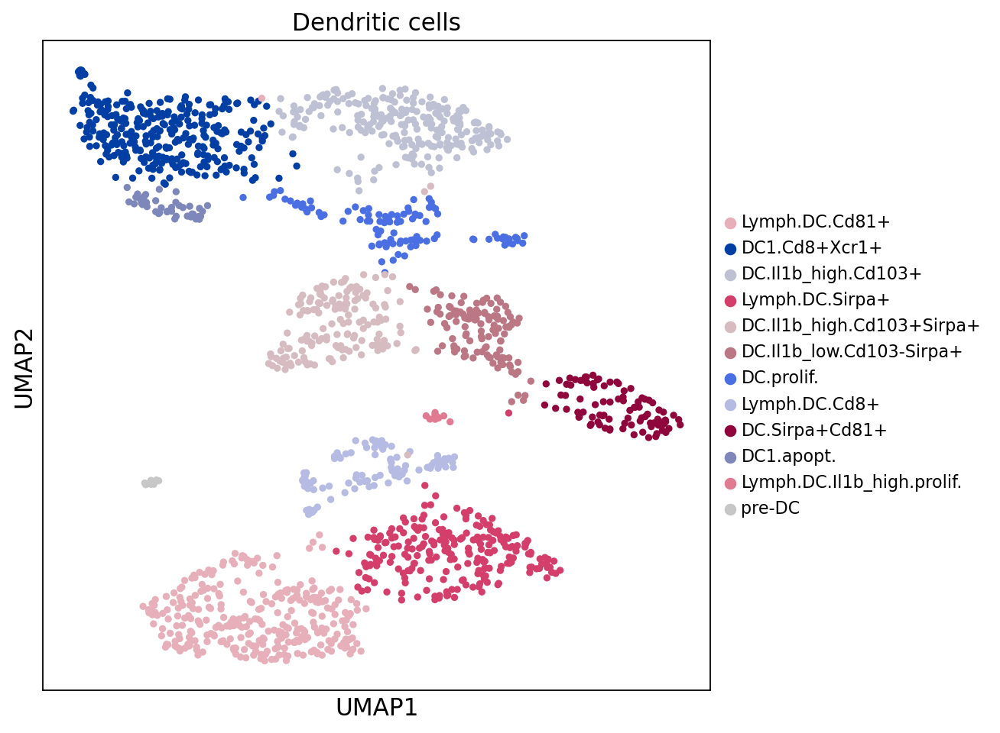

In [177]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_DC, color = ['cell_subset'], title="Dendritic cells",  
            frameon=True, legend_fontsize=10, legend_fontoutline=1,
              palette={'DC1.Cd8+Xcr1+': '#023fa5ff',
             'DC1.apopt.': '#7d87b9ff',
             'DC.Il1b_high.Cd103+': '#bec1d4ff',
             'DC.Il1b_high.Cd103+Sirpa+': '#d6bcc0ff',
             'DC.Il1b_low.Cd103-Sirpa+': '#bb7784ff',
             'DC.Sirpa+Cd81+': '#8e063bff',
             'DC.prolif.': '#4a6fe3ff',
             'Lymph.DC.Cd8+': '#b5bbe3ff',
             'Lymph.DC.Cd81+': '#e6afb9ff',
             'Lymph.DC.Il1b_high.prolif.': '#e07b91ff',
             'Lymph.DC.Sirpa+': '#d33f6aff',
             'pre-DC': '#c7c7c7ff'})

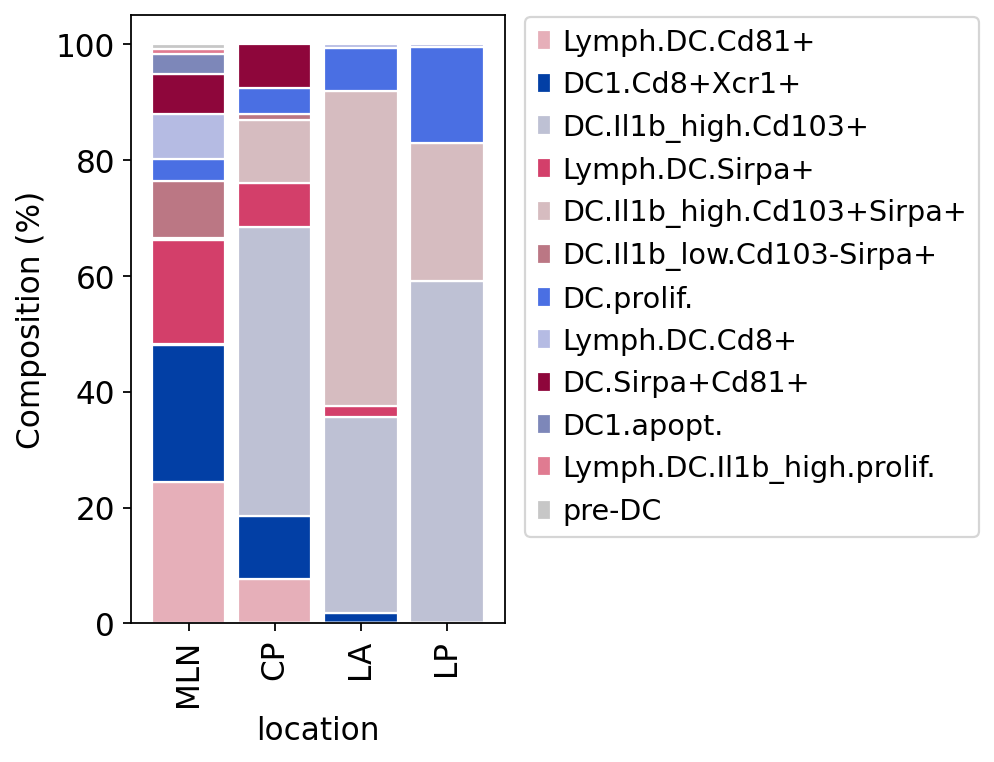

In [178]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp13 = pd.crosstab(adata_DC.obs['location'], adata_DC.obs['cell_subset'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot13=tmp13.reindex(sort_mapping.index)
    plot13.plot(kind='bar', stacked=True, color= adata_DC.uns['cell_subset_colors'],edgecolor='white', width=0.85, ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/DCs_UMAP_bars_final.pdf', format='pdf')

In [184]:
tmp13.T.to_csv("SuppFig4A_Barplot_DCs.csv")

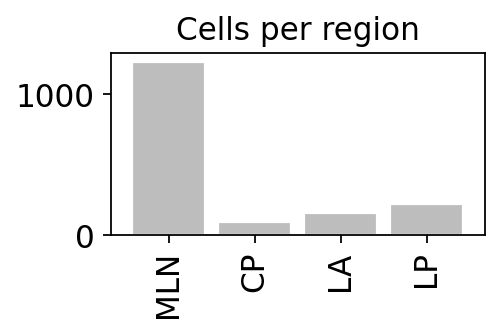

In [179]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp14 =adata_DC.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot14=tmp14.reindex(sort_mapping.index)
    plot14.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/DCs_UMAP_Cells_final.pdf', format='pdf')

In [180]:
tmp14

MLN    1230
LP      223
LA      160
CP       92
Name: location, dtype: int64

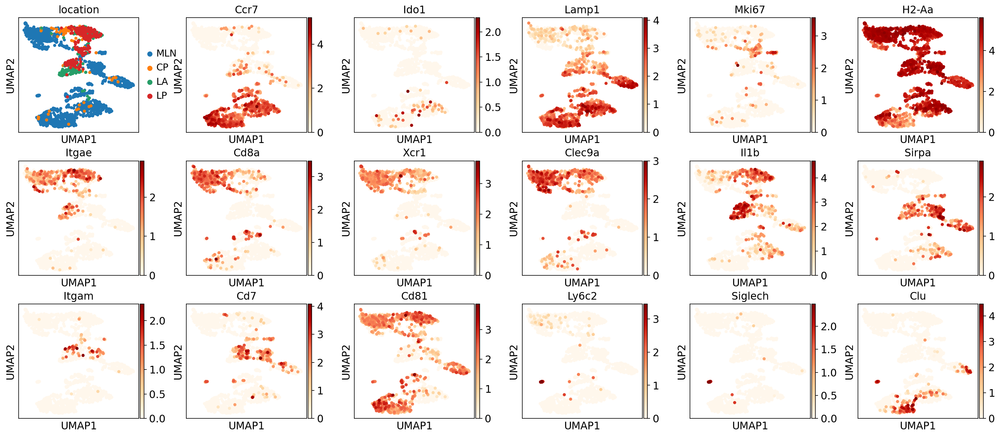

In [181]:
with mpl.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata_DC, color=['location','Ccr7','Ido1','Lamp1','Mki67','H2-Aa','Itgae','Cd8a','Xcr1','Clec9a','Il1b','Sirpa','Itgam','Cd7','Cd81','Ly6c2','Siglech','Clu'],
               ncols=6)

In [182]:
sc.tl.rank_genes_groups(adata_DC, groupby='cell_subset', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_subset']`


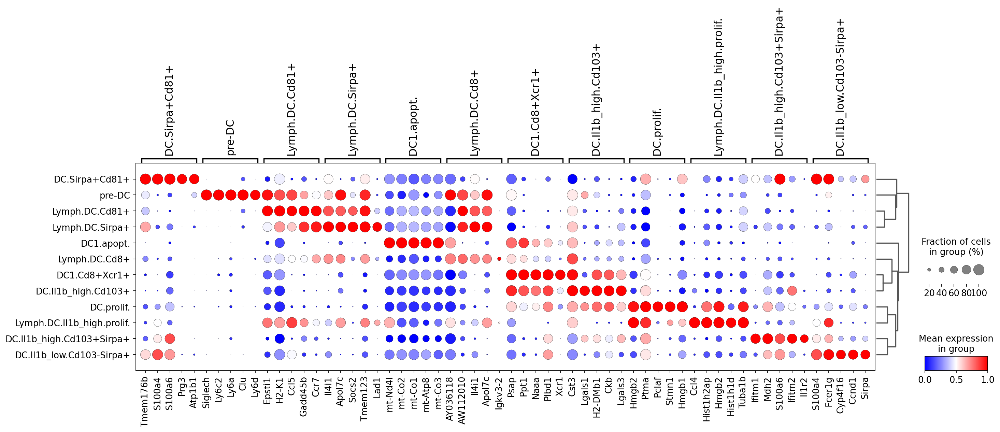

In [183]:
sc.tl.dendrogram(adata_DC, groupby='cell_subset')
sc.pl.rank_genes_groups_dotplot(adata_DC, n_genes=5, min_logfoldchange=1.9, cmap='bwr',figsize=(20,5),standard_scale='var')

In [186]:
de_DCs = find_marker_genes(adata_DC)

In [187]:
de_DCs.to_csv('GEtable_markers-MoMac.csv', header=True, index=False)

## Stromal cells: Mesenchymal, endothelial, vascular and neural cells  (SuppFig.4c)

In [188]:
adata_STR=sc.read(path+'/h5ad_files/Stromal_clean.h5ad')

In [189]:
adata_STR.obs["cell_subset"].value_counts()

Fibroblast_Adamdec1+Pdgfra_low     466
Endothelial.cells                  309
Fibroblast_Endosialin+             158
Fibroblast_Cxcl12+                 113
Pericytes                           92
Lymphatic_endothelium               64
Fibroblast.Adamdec1+Pdgfra_high     62
Myofibroblast                       61
Lymphatics_lacteals                 59
Glial cells                         10
Fibroblast_Acta2+                    6
Name: cell_subset, dtype: int64

In [190]:
len(adata_STR)

1400

In [191]:
adata_STR.obs["cell_subset"]= adata_STR.obs["cell_subset"].cat.rename_categories({'Lymphatics_lacteals': 'Lymphatic_capillary'})

In [192]:
adata_STR.obs["cell_subset"].value_counts()

Fibroblast_Adamdec1+Pdgfra_low     466
Endothelial.cells                  309
Fibroblast_Endosialin+             158
Fibroblast_Cxcl12+                 113
Pericytes                           92
Lymphatic_endothelium               64
Fibroblast.Adamdec1+Pdgfra_high     62
Myofibroblast                       61
Lymphatic_capillary                 59
Glial cells                         10
Fibroblast_Acta2+                    6
Name: cell_subset, dtype: int64

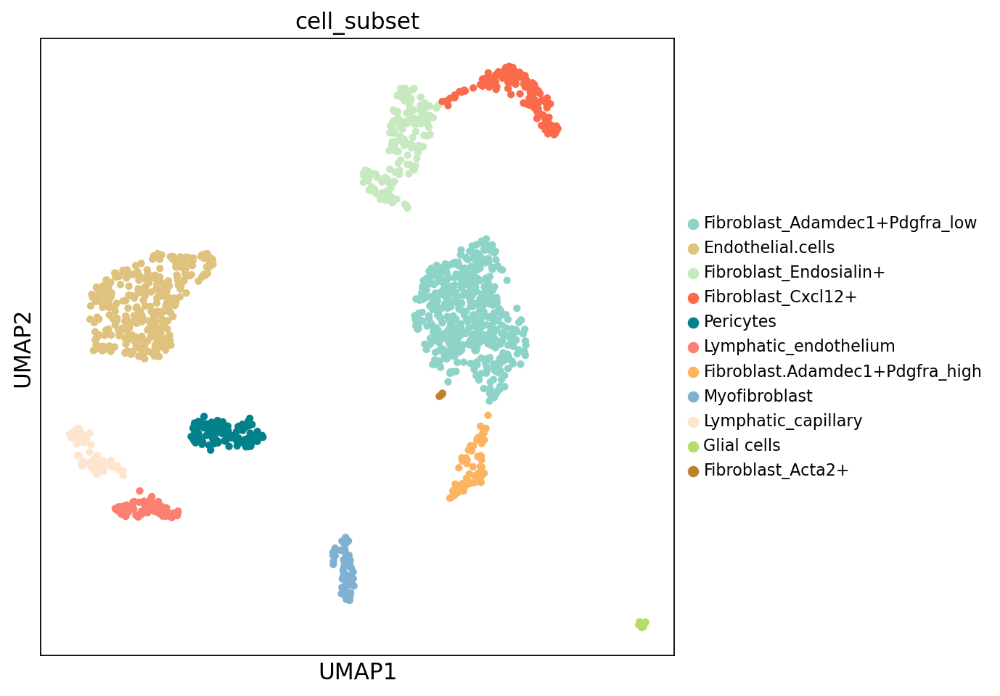

In [193]:
with mpl.rc_context({'figure.figsize': (7, 7)}):
    sc.pl.umap(adata_STR, color=['cell_subset'],
        legend_fontsize=10, legend_fontoutline=1)

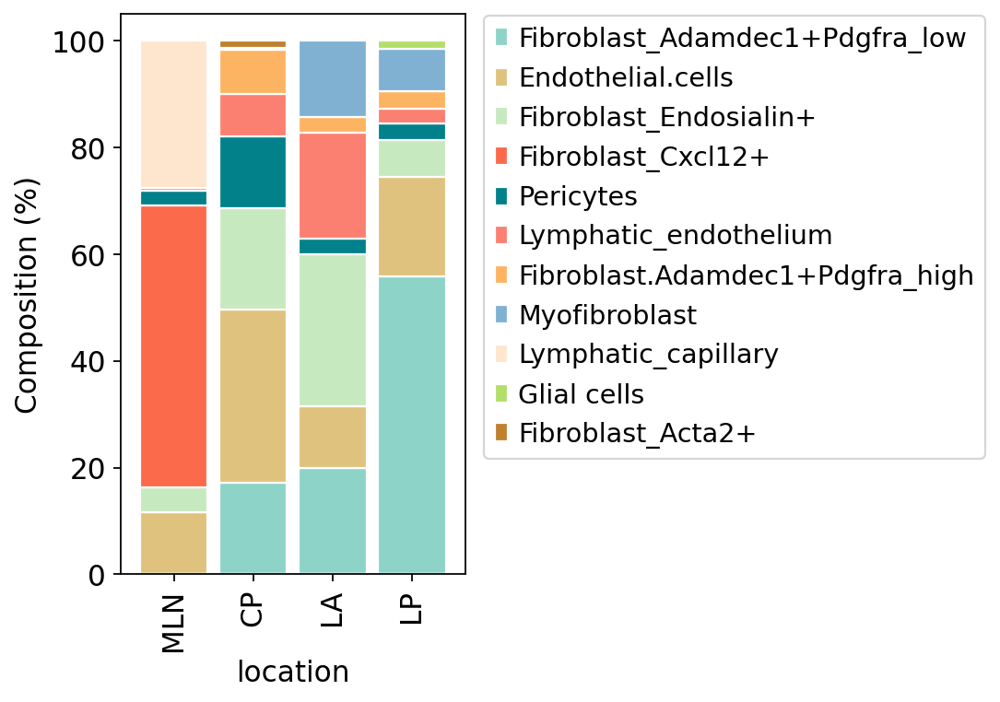

In [194]:
with mpl.rc_context({'figure.figsize': (3, 5)}):
    tmp15 = pd.crosstab(adata_STR.obs['location'], adata_STR.obs['cell_subset'], normalize='index')*100
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot15=tmp15.reindex(sort_mapping.index)
    plot15.plot(kind='bar', stacked=True, color= adata_STR.uns['cell_subset_colors'],edgecolor='white', width=0.85,ylabel="Composition (%)", grid=False).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.05)
#mpl.savefig(path+'/figures/Stromal_bar_final.pdf', format='pdf')

In [198]:
tmp15.T.to_csv('SuppFig4C_Barplot_Stromal.csv')

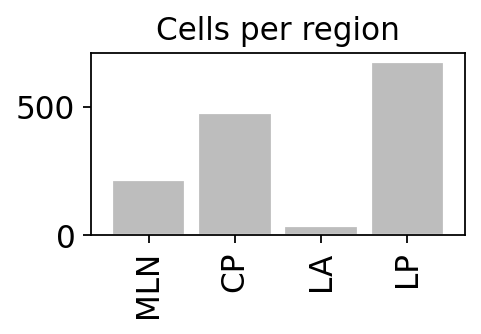

In [196]:
with mpl.rc_context({'figure.figsize': (3, 1.5)}):
    tmp16 =adata_STR.obs['location'].value_counts()
    df_mapping = pd.DataFrame({'LocOrdered': ['MLN', 'CP', 'LA', 'LP'],})
    sort_mapping = df_mapping.reset_index().set_index('LocOrdered')
    plot16=tmp16.reindex(sort_mapping.index)
    plot16.plot(kind='bar', color=['#bdbdbd'],title='Cells per region',edgecolor='white', width=0.85, grid=False)
#mpl.savefig(path+'/figures/Stromal_cells_final.pdf', format='pdf')

In [197]:
tmp16

LP     675
CP     476
MLN    214
LA      35
Name: location, dtype: int64

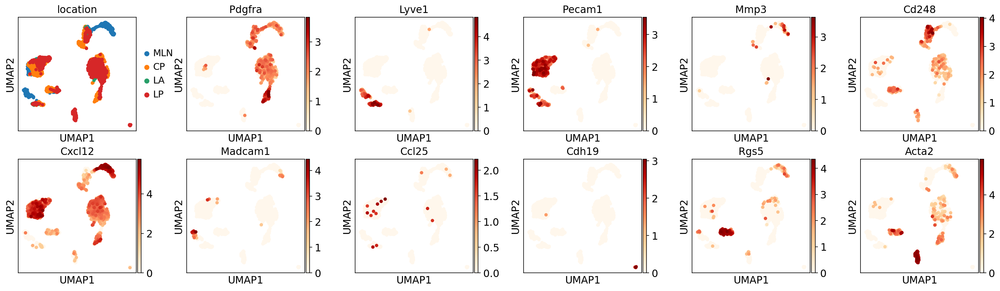

In [199]:
with mpl.rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata_STR, color=['location','Pdgfra','Lyve1','Pecam1','Mmp3','Cd248','Cxcl12','Madcam1','Ccl25','Cdh19',
                                 'Rgs5','Acta2'],color_map='OrRd',ncols=6, wspace=0.3)

In [200]:
sc.tl.rank_genes_groups(adata_STR, groupby='cell_subset', method='wilcoxon',pts=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_subset']`


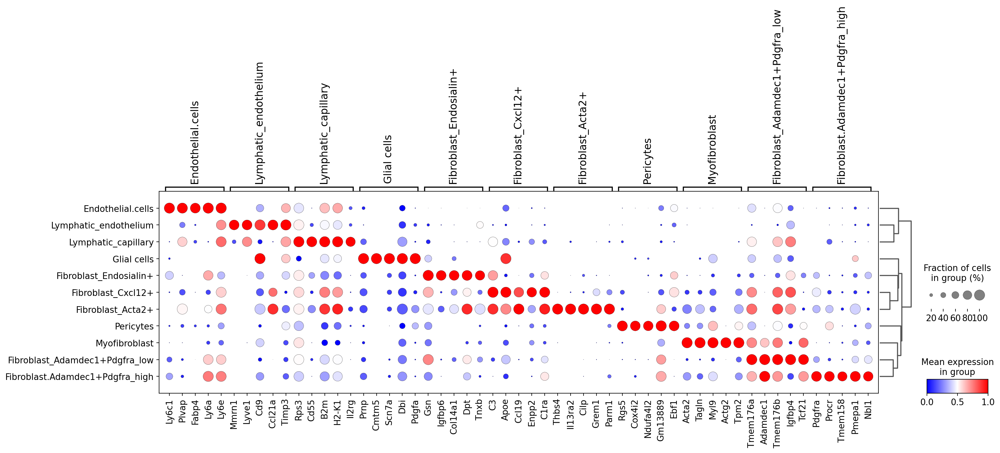

In [201]:
sc.tl.dendrogram(adata_STR, groupby='cell_subset')
sc.pl.rank_genes_groups_dotplot(adata_STR, n_genes=5, min_logfoldchange=1.9, cmap='bwr',figsize=(20,5),standard_scale='var')

In [202]:
de_STR = find_marker_genes(adata_STR)

In [203]:
de_STR.to_csv('GEtable_markers-STR.csv', header=True, index=False)

In [204]:
adata_STR.write(path+'/h5ad_files/Stromal_clean_final.h5ad')

---